In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.cluster import KMeans
import statsmodels.api as sm
from scipy.stats import f
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.cluster import DBSCAN

from scipy.stats import expon
from scipy.optimize import curve_fit
import scipy.stats as ss
from scipy.optimize import minimize

from scipy.linalg import inv, pinv, eigh

In [ ]:
! python --version

Python 3.10.12


In [ ]:
from google.colab import drive
drive.mount("/drive")

Mounted at /drive


In [ ]:

data=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/I94/I94sample.csv")
lc_df=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/I94/lc_df.csv")
#preloaded_clusters=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/clustersI395.csv")


In [ ]:
lc_df

,Unnamed: 0,ID,time,location,old_lane,new_lane
0,0,38,5.6,512.982930,13,12
1,2,72,12.7,489.030812,11,10
2,3,76,3.2,399.009812,12,11
3,4,76,13.2,440.613527,11,10
4,5,90,17.4,442.118104,12,11
...,...,...,...,...,...,...
576,654,14879,803.5,114.299467,11,12
577,655,14953,801.8,82.853983,10,11
578,656,15019,801.9,62.341131,14,13
579,657,15019,810.3,137.948124,13,12


In [ ]:
max_t=800
min_t=0
min_x=100
max_x=500
rel_data=data[(data["time"]>=min_t) & (data["time"]<max_t)]
rel_data=rel_data[(rel_data["dist_cntr"]>=min_x) & (rel_data["dist_cntr"]<max_x)]
rel_lc_df=lc_df[(lc_df["time"]>=min_t) & (lc_df["time"]<=max_t)]
rel_lc_df=rel_lc_df[(rel_lc_df["location"]>=min_x) & (rel_lc_df["location"]<=max_x)]
lanes=[10,11,12,13,14,15]#[-3,-4,-5]

# Victor

In [ ]:
lane_data=rel_data[rel_data["lane-kf"]==-3]
#lane_data=lane_data[lane_data["time"]<=10]
#plt.figure(figsize=(80,5))
#plt.scatter(lane_data["time"], lane_data["dist_cntr"], s=0.1)

NameError: name 'rel_data' is not defined

In [ ]:
ids=lane_data[(lane_data["time"]==0) & (lane_data["dist_cntr"]<=200)]["ID"].unique()
for id in ids:
  veh=lane_data[lane_data["ID"]==id]
  plt.scatter(veh["time"], veh["dist_cntr"], s=1 )
  plt.xlabel("time(s)", fontsize=12, fontname='Times New Roman')
  plt.ylabel("position(m)", fontsize=12, fontname='Times New Roman')
  plt.title("Selected Trajectories on I395 from TGSIM",fontsize=12, fontname='Times New Roman')

NameError: name 'lane_data' is not defined

In [ ]:
sub_data

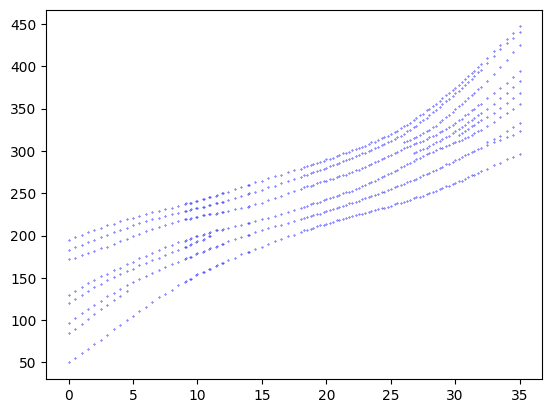

In [ ]:
sub_data=lane_data[lane_data['time']<=50]
veh_low=sub_data[sub_data["ID"]==623]
veh_high=sub_data[sub_data["ID"]==599]

for step in range(0, 500):
  t=step*0.1
  data_t=sub_data[sub_data["time"]==t]
  min_x=veh_low[veh_low["time"]==t]["dist_cntr"].values
  max_x=veh_high[veh_high["time"]==t]["dist_cntr"].values
  if len(min_x)==0 or len(max_x)==0:
    continue
  min_x=min_x[0]
  max_x=max_x[0]
  #high_x=data_t[data_t[""]]
  between_data=data_t[(data_t["dist_cntr"]>=min_x) & (data_t["dist_cntr"]<=max_x)]
  plt.scatter(between_data["time"], between_data["dist_cntr"], s=0.1, color="blue")

In [ ]:
lane_data[(lane_data["time"]==0) & (lane_data["dist_cntr"]<=200)]

,Unnamed: 0.1,Unnamed: 0,ID,time,xloc-kf,yloc-kf,lane-kf,speed-kf,acceleration-kf,length-smoothed,width-smoothed,type-most-common,segment,dist_cntr
35108,62914,94272,599,0.0,352.727,90.398,-3,5.662,0.212,6.200,2.200,1.0,195.0,195.025943
35847,64131,95876,602,0.0,340.563,90.688,-3,5.715,0.136,6.200,2.200,1.0,183.0,183.025629
37087,66296,98041,606,0.0,329.132,90.471,-3,5.132,-0.373,6.200,2.200,1.0,172.0,172.025028
38423,68102,100953,612,0.0,287.651,91.649,-3,9.910,-1.175,6.200,2.200,1.0,130.0,130.021782
40396,70829,104070,618,0.0,254.851,91.189,-3,10.839,0.118,6.200,2.200,1.0,97.0,97.019289
41157,71827,105068,620,0.0,277.587,90.768,-3,10.256,-0.453,5.758,1.914,1.0,120.0,120.020886
41499,72252,105493,621,0.0,242.113,91.332,-3,11.211,-0.069,6.200,2.200,1.0,85.0,85.018960
41975,72782,106392,623,0.0,206.975,91.248,-3,10.995,0.102,6.200,2.200,1.0,50.0,50.017924


In [ ]:
lane_

# ShockWave Detection

In [ ]:
def p_distance(p1, p2):
    t1, x1 = p1
    t2, x2 = p2
    t_diff = np.abs(t1 - t2) > max_t_diff
    x_diff = np.abs(x1 - x2) > max_x_diff
    return (t_diff.astype(int) + x_diff.astype(int)).sum()

## Run from Scratch

In [ ]:
rel_data

,Unnamed: 0,ID,time,xloc-kf,yloc-kf,lane-kf,speed-kf,acceleration-kf,length-smoothed,width-smoothed,type-most-common,segment,dist_cntr,lane_group
0,0,33,0.0,914.17,391.370000,12,5.478202,0.771124,5.087585,2.313385,small-vehicle,285.0,442.118104,1
1,1,33,0.1,914.41,391.862450,12,5.555315,0.729682,5.087585,2.313385,small-vehicle,286.0,443.622680,1
2,2,33,0.2,914.66,392.358550,12,5.628283,0.598664,5.087585,2.313385,small-vehicle,286.0,443.622680,1
3,3,33,0.3,914.92,392.857725,12,5.688149,0.470515,5.087585,2.311058,small-vehicle,286.0,443.622680,1
4,4,33,0.4,915.19,393.358375,12,5.735201,-0.102516,5.087585,2.311058,small-vehicle,287.0,445.127257,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1152185,1152185,15386,119.8,954.52,426.412300,15,8.831756,-0.816443,5.015438,2.171417,small-vehicle,322.0,496.128064,0
1152186,1152186,15386,119.9,955.15,427.031250,15,8.750111,0.608204,5.017765,2.171417,small-vehicle,323.0,497.536063,0
1152187,1152187,15386,120.0,955.77,427.648700,15,8.810932,-0.137960,5.020092,2.169089,small-vehicle,323.0,497.536063,0
1152188,1152188,15386,120.1,956.40,428.264675,15,8.797136,-0.853967,5.022420,2.169089,small-vehicle,324.0,498.944061,0


332


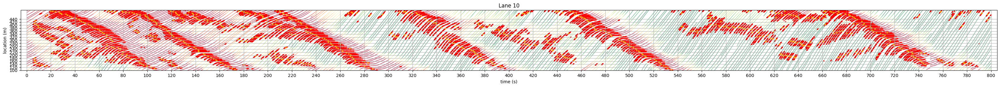

366


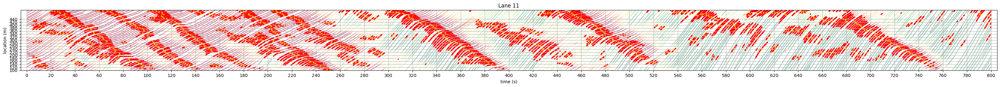

352


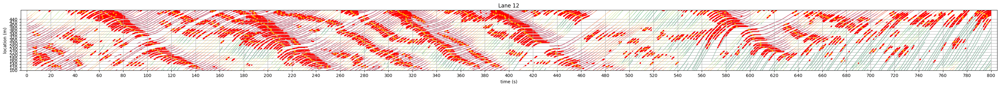

403


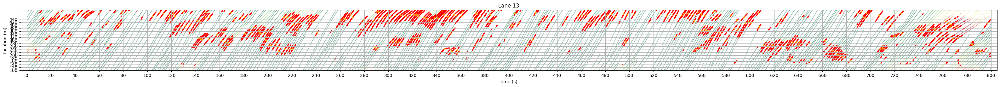

477


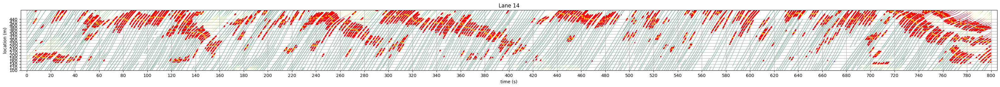

467


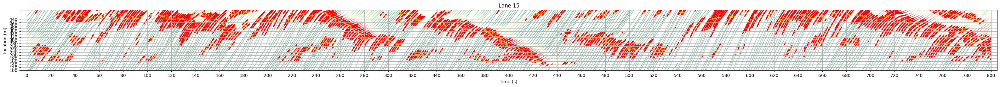

In [ ]:
# visualize speed drop of greater than n% in t s
#colors={-3:"b", -4:"o", -5:"g"}
inf_xs_by_lane={10:[], 11:[], 12:[], 13:[], 14:[], 15:[]}
inf_ts_by_lane={10:[], 11:[], 12:[], 13:[], 14:[], 15:[]}
slow_down_xs={}
slow_down_ts={}

slow_down_group_xs={}
slow_down_group_ts={}
slow_down_group_ids={}

spd_drop_step=5
spd_drop_factor=0.9
spd_incr_factor=1.2


for lane in lanes:

  plt.figure(figsize=(40,2.5))
  lane_data=rel_data[( rel_data["lane-kf"]==lane)  ]
  color_bar = np.maximum(np.minimum(lane_data["speed-kf"].values, 10*np.ones(len(lane_data))), 5*np.ones(len(lane_data)))
  plt.scatter(lane_data["time"], lane_data["dist_cntr"], c=color_bar, cmap='RdYlGn',  s=0.01)

  ids=lane_data["ID"].unique()

  wave_start_xs=[]
  wave_start_ts=[]
  wave_all_xs=[]
  wave_all_ts=[]
  print(len(ids))
  for id in ids:
    veh=lane_data[lane_data["ID"]==id]
    if len(veh)<10*spd_drop_step:
      continue
    pos1=veh["dist_cntr"].values[:-10*spd_drop_step]
    pos2=veh["dist_cntr"].values[10*spd_drop_step:]
    spd1=veh["speed-kf"].values[:-10*spd_drop_step]
    spd2=veh["speed-kf"].values[10*spd_drop_step:]
    time1=veh["time"].values[:-10*spd_drop_step]
    time2=veh["time"].values[10*spd_drop_step:]

    #print(time2-time1)
    inf_time_dec=time2[(spd2<=spd1*spd_drop_factor) & (spd1!=0) & (time2-time1>=spd_drop_step-0.2) & (time2-time1<=spd_drop_step+0.2)]
    inf_pos_dec=pos2[(spd2<=spd1*spd_drop_factor) & (spd1!=0) & (time2-time1>=spd_drop_step-0.2) & (time2-time1<=spd_drop_step+0.2)]


    # now determine the split points:
    #'''
    if len(inf_time_dec)==1:
      start_slow_t=inf_time_dec[0]
      start_slow_x=inf_pos_dec[0]
    elif len(inf_time_dec)==0:
      pass

    else:
      min_wvt=0
      max_wvt=len(inf_time_dec)
      inf_time_dec1=inf_time_dec[1:]
      inf_time_dec0=inf_time_dec[:-1]
      time_breaks=np.where(inf_time_dec1-inf_time_dec0>1)[0]
      #print(time_breaks)
      time_breaks=np.concatenate(([min_wvt], time_breaks, [max_wvt]))

      for tb in range(len(time_breaks)-1):
        step0=time_breaks[tb]+1
        step1=time_breaks[tb+1]+1
        if len(inf_time_dec[step0:step1])==0:
            continue
        if max(inf_time_dec[step0:step1])-min(inf_time_dec[step0:step1])<2:
            continue
        t_center=np.median(inf_time_dec[step0:step1])

        #print(inf_time_dec[step0:step1])
        x_center=np.median(inf_pos_dec[step0:step1])


        wave_start_xs.append(x_center)
        wave_start_ts.append(t_center)
        wave_all_xs.append(inf_pos_dec[(step0+step1)//2:step1])
        wave_all_ts.append(inf_time_dec[(step0+step1)//2:step1])
    #'''


    inf_xs_by_lane[lane]=np.concatenate((inf_xs_by_lane[lane], inf_pos_dec))
    inf_ts_by_lane[lane]=np.concatenate((inf_ts_by_lane[lane], inf_time_dec))

    plt.scatter(inf_time_dec, inf_pos_dec, color="red", s=2 )
    #'''
    plt.scatter(wave_start_ts, wave_start_xs, color="orange", s=4)
    #'''

  plt.xticks([i*20 for i in range(0,int(max_t//20+1))])
  plt.yticks([i*20 for i in range(23)])
  plt.xlim(-5, max_t+5)
  plt.ylim(100, 500)
  plt.title("Lane "+str(lane))

  plt.xlabel("time (s)")
  plt.ylabel("location (m)")
  plt.grid(True)
  plt.show()

  #'''
  slow_down_xs[lane]=wave_start_xs # just one point on each trajectory
  slow_down_ts[lane]=wave_start_ts
  slow_down_group_xs[lane]=wave_all_xs # all points on a trajectory
  slow_down_group_ts[lane]=wave_all_ts
  #'''

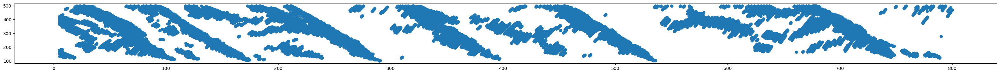

In [ ]:
plt.figure(figsize=(40,2.5))
plt.scatter(inf_ts_by_lane[10], inf_xs_by_lane[10])

In [ ]:
max_t_diff=10
max_x_diff=50

10
Estimated number of clusters: 16
Estimated number of noise points: 31


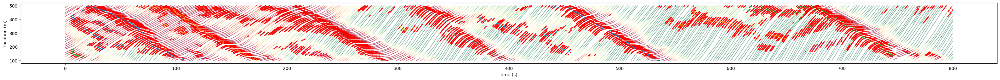

11
Estimated number of clusters: 21
Estimated number of noise points: 45


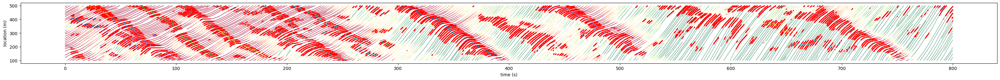

12
Estimated number of clusters: 24
Estimated number of noise points: 38


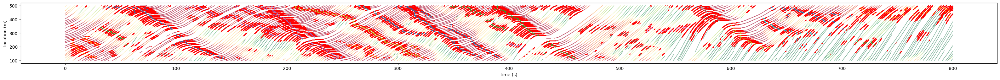

13
Estimated number of clusters: 22
Estimated number of noise points: 60


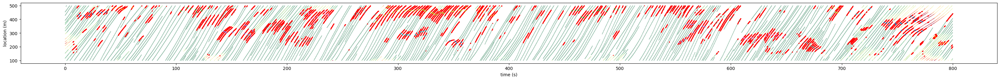

14
Estimated number of clusters: 13
Estimated number of noise points: 72


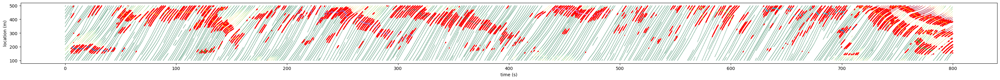

15
Estimated number of clusters: 19
Estimated number of noise points: 41


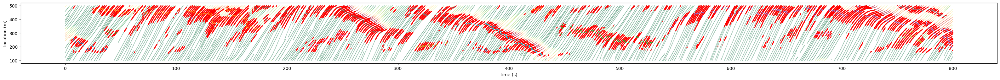

In [ ]:
t_groups_lane={}
x_groups_lane={}
num_traj_groups_lane={}
for lane in lanes:
    print(lane)
    t_groups_lane[lane]=[]
    x_groups_lane[lane]=[]
    num_traj_groups_lane[lane]=[]
    xs=np.array(slow_down_xs[lane])#np.array(inf_xs_by_lane[lane])
    ts=np.array(slow_down_ts[lane])#np.array(inf_ts_by_lane[lane])

    X=np.transpose([ts, xs])


    db = DBSCAN(eps=0.5, min_samples=5, metric=p_distance).fit(X)
    labels = db.labels_

  # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of noise points: %d" % n_noise_)

    lbs=np.unique(labels)


    plt.figure(figsize=(40,2.5))
    lane_data=rel_data[( rel_data["lane-kf"]==lane)  ]
    color_bar = np.maximum(np.minimum(lane_data["speed-kf"].values, 10*np.ones(len(lane_data))), 5*np.ones(len(lane_data)))
    plt.scatter(lane_data["time"], lane_data["dist_cntr"], c=color_bar, cmap='RdYlGn',  s=0.01)

    plt.scatter(inf_ts_by_lane[lane], inf_xs_by_lane[lane], color="red", s=1 )

    for lb in lbs:
        if lb==-1:
            continue
        t_groups_lane[lane].append([])
        x_groups_lane[lane].append([])

        x_rel=xs[labels==lb]
        t_rel=ts[labels==lb]
        #num_traj_groups_lane[lane].append(len())

        lb_idxes=np.where(labels==lb)[0] # a list for that label
        num_traj_groups_lane[lane].append(len(lb_idxes))

        for idx in lb_idxes:
            t_groups_lane[lane][-1]=np.concatenate((t_groups_lane[lane][-1], slow_down_group_ts[lane][idx]))
            x_groups_lane[lane][-1]=np.concatenate((x_groups_lane[lane][-1], slow_down_group_xs[lane][idx]))
            #plt.scatter(slow_down_group_ts[lane][idx], slow_down_group_xs[lane][idx], s=5)

        plt.scatter(t_rel, x_rel, s=5)
        #plt.scatter(t_groups_lane[lane][-1], x_groups_lane[lane][-1], s=1)


    plt.xlabel("time (s)")
    plt.ylabel("location (m)")
    plt.show()

## Read pre-clustered

In [ ]:
lanes=[10,11,12,13,14,15]#[-3,-4,-5]

In [ ]:
t_wd=1
x_wd=10

In [ ]:
inf_xs_by_lane={}
inf_ts_by_lane={}
t_groups_lane={}
x_groups_lane={}
for lane in lanes:
  lane_pts=preloaded_clusters[preloaded_clusters["lane"]==lane]
  inf_xs_by_lane[lane]=lane_pts["x"].values
  inf_ts_by_lane[lane]=lane_pts["t"].values
  t_groups_lane[lane]=[]
  x_groups_lane[lane]=[]


  max_group=int(max(lane_pts["group"]))
  for group in range(0, max_group+1):
    group_pts=lane_pts[lane_pts["group"]==group]
    t_groups_lane[lane].append(group_pts["t"].values)
    x_groups_lane[lane].append(group_pts["x"].values)


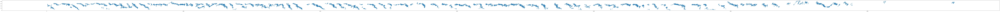

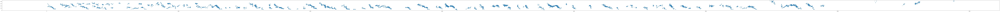

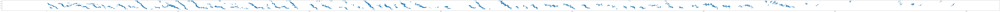

In [ ]:
# instead of using the clusters: using space time slots

min_pts=5
wave_binary={-3:np.zeros(((max_x-min_x)//x_wd, (max_t-min_t)//t_wd )), -4:np.zeros(((max_x-min_x)//x_wd, (max_t-min_t)//t_wd )), -5:np.zeros(((max_x-min_x)//x_wd, (max_t-min_t)//t_wd ))}
wave_xs={-3:[], -4:[], -5:[]}
wave_ts={-3:[], -4:[], -5:[]}

for lane in lanes:
  x_waves=[]
  t_waves=[]
  inf_xs=inf_xs_by_lane[lane]
  inf_ts=inf_ts_by_lane[lane]
  for t in range(min_t, max_t, t_wd):
    for x in range(min_x, max_x, x_wd):
      rel=inf_xs[(inf_xs>x) & (inf_xs<x+x_wd) & (inf_ts>t) & (inf_ts<t+t_wd)]
      if len(rel)>=min_pts:
        wave_binary[lane][(x-min_x)//x_wd][(t-min_t)//t_wd]=1
        wave_xs[lane].append(x)
        wave_ts[lane].append(t)

        x_waves.append(x)
        t_waves.append(t)
  plt.figure(figsize=(max_t//25,3))
  plt.scatter(t_waves, x_waves, s=15)
  plt.show()




In [ ]:
'''
pd.DataFrame(wave_binary[-3]).to_csv('/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary3.csv', index=False, header=False)
pd.DataFrame(wave_binary[-4]).to_csv('/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary4.csv', index=False, header=False)
pd.DataFrame(wave_binary[-5]).to_csv('/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary5.csv', index=False, header=False)
'''

In [ ]:
# save the wave locations
'''
pd.DataFrame({"t":wave_ts[-3], "x":wave_xs[-3]}).to_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete3.csv")
pd.DataFrame({"t":wave_ts[-4], "x":wave_xs[-4]}).to_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete4.csv")
pd.DataFrame({"t":wave_ts[-5], "x":wave_xs[-5]}).to_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete5.csv")
'''

In [ ]:
wave_discrete3=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete3.csv")
wave_discrete4=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete4.csv")
wave_discrete5=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_discrete5.csv")
wave_xs={-3:wave_discrete3["x"].values, -4: wave_discrete4["x"].values, -5:wave_discrete5["x"].values}
wave_ts={-3:wave_discrete3["t"].values, -4: wave_discrete4["t"].values, -5:wave_discrete5["t"].values}

In [ ]:
wave_binary3=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary3.csv").to_numpy()
wave_binary4=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary4.csv").to_numpy()
wave_binary5=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_wave_binary5.csv").to_numpy()
wave_binary={-3:wave_binary3, -4:wave_binary4, -5:wave_binary5}

In [ ]:

import copy

In [ ]:
# smoothen shockwave points
new_wave_binary={}
new_wave_ts={}
new_wave_xs={}
for lane in lanes:
  new_wave_ts[lane]=[]
  new_wave_xs[lane]=[]
  new_wave_binary[lane]=copy.deepcopy(wave_binary[lane])#np.zeros((len(wave_binary[lane]), len(wave_binary[lane][0])))
  for x_idx in range(0,len(wave_binary[lane])):
    min_x_idx=max(x_idx-2,0)
    max_x_idx=min(x_idx+2,len(wave_binary[lane]))
    for t_idx in range(0,len(wave_binary[lane][0])):
      min_t_idx=max(t_idx-5,0)
      max_t_idx=min(t_idx+5,len(wave_binary[lane][0]))
      if sum(sum(wave_binary[lane][min_x_idx:max_x_idx, min_t_idx:max_t_idx]))>=10:
        new_wave_binary[lane][x_idx][t_idx]=1
        new_wave_xs[lane].append(x_idx*x_wd+min_x)
        new_wave_ts[lane].append(t_idx*t_wd+min_t)







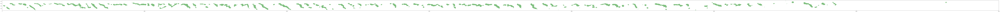

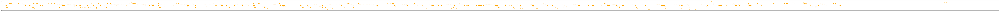

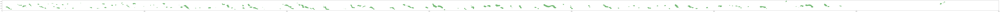

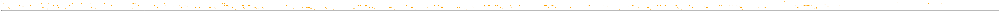

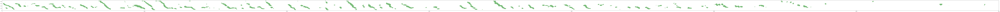

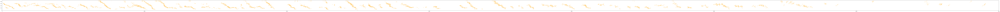

In [ ]:
for lane in lanes:
  plt.figure(figsize=(max_t//25,3))
  plt.xlim(0,7000)
  plt.scatter(new_wave_ts[lane], new_wave_xs[lane], s=2, color="green")
  plt.show()

  plt.figure(figsize=(max_t//25,3))
  plt.xlim(0,7000)
  plt.scatter(wave_ts[lane], wave_xs[lane], s=2, color="orange")
  plt.show()

  print()

In [ ]:
# Initiation of a shockwave related to itself (how long the shockwave has not appeared), the interaction of adjacent lane
# Extensison of a shockwave related to itself (how long the shockwave has been there), the interaction of adjacent lane

#

12204.0

-3


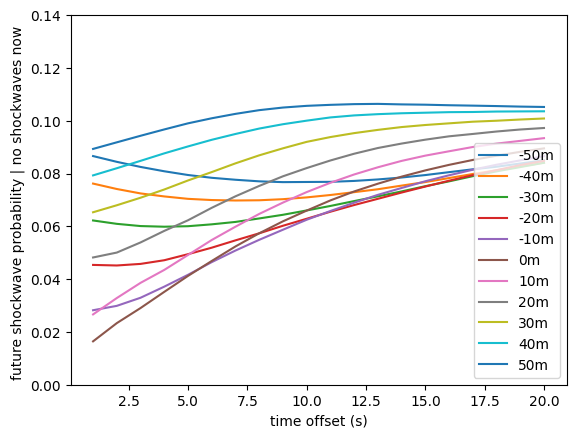

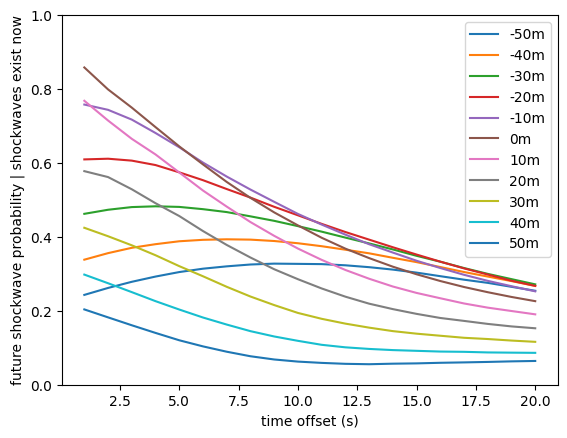

-4


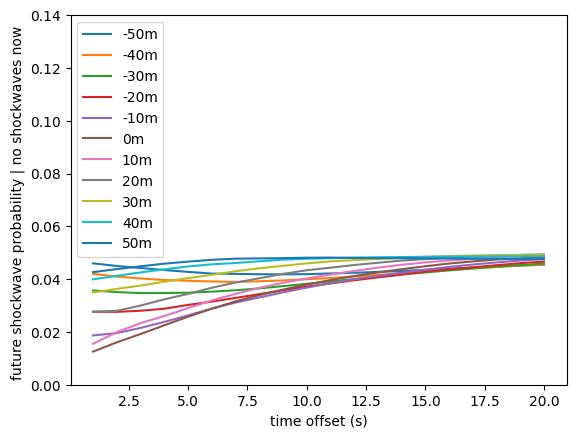

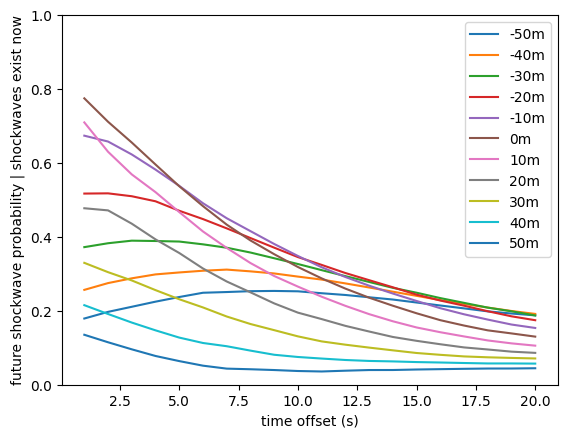

-5


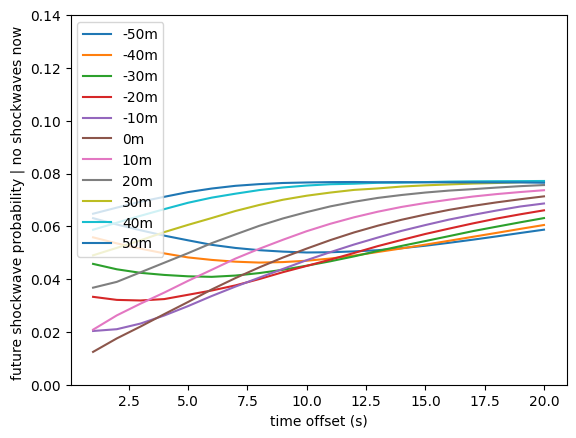

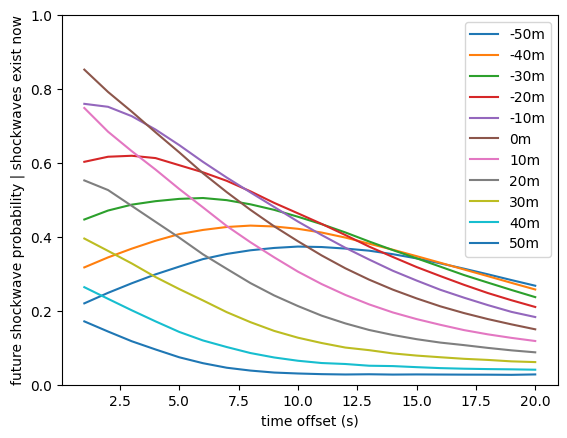

In [ ]:
# how does the past shockwave information affect the future
# if there is a shockwave now, how likely there is one more in the future at a certain time and location
# same lane
max_x_offset=5
max_t_offset=20

for lane in lanes:
  wave_gen_probs=[]
  wave_con_probs=[]
  print(lane)
  for x_offset in range(-max_x_offset,max_x_offset+1):
    wave_gen_probs.append([])
    wave_con_probs.append([])
    for t_offset in range(1, max_t_offset+1):

    #print("x and t shift", x_offset*x_wd, t_offset*t_wd)


      #wave_gen_prob=[]
      #wave_con_prob=[]
      #print("lane", lane)


      current_state=new_wave_binary[lane][ max_x_offset:-max_x_offset-1 , 0:-max_t_offset-1]
      future_state=new_wave_binary[lane][ max_x_offset+x_offset: -max_x_offset-1+x_offset , t_offset:-max_t_offset-1+t_offset ]
      # current no wave, future wave
      wave01=sum(sum((current_state==0)*(future_state==1)*1))
      # current wave, future wave
      wave11=sum(sum((current_state==1)*(future_state==1)*1))
      # current no wave, future no wave
      wave00=sum(sum((current_state==0)*(future_state==0)*1))
      # current wave, future no wave
      wave10=sum(sum((current_state==1)*(future_state==0)*1))
      #print("Wave generation prob", wave01/ (wave00+wave01) )
      #print("Wave continuation prob", wave11/ (wave11+wave10) )

      #wave_gen_probs[x_offset][t_offset].append(wave01/ (wave00+wave01))
      #wave_con_probs[x_offset][t_offset].append(wave11/ (wave11+wave10))
      wave_gen_probs[-1].append(wave01/ (wave00+wave01) )
      wave_con_probs[-1].append(wave11/ (wave11+wave10))

  for i in range(len(wave_gen_probs)):
    #print((-max_x_offset+i)*x_wd)
    #print(wave_gen_probs[i])
    plt.plot([t_offset for t_offset in range(1, max_t_offset+1)], wave_gen_probs[i])
    #print()
  plt.legend([str(x_offset*x_wd)+"m" for x_offset in range(-max_x_offset,max_x_offset+1)])
  plt.ylim(0,0.14)
  plt.xlabel("time offset (s)")
  plt.ylabel("future shockwave probability | no shockwaves now ")
  plt.show()

  for i in range(len(wave_con_probs)):
    #print((-max_x_offset+i)*x_wd)
    #print(wave_gen_probs[i])
    plt.plot([t_offset for t_offset in range(1, max_t_offset+1)], wave_con_probs[i])
    #print()
  plt.legend([str(x_offset*x_wd)+"m" for x_offset in range(-max_x_offset,max_x_offset+1)])
  plt.ylim(0, 1)
  plt.xlabel("time offset (s)")
  plt.ylabel("future shockwave probability | shockwaves exist now")
  plt.show()


-3 -3


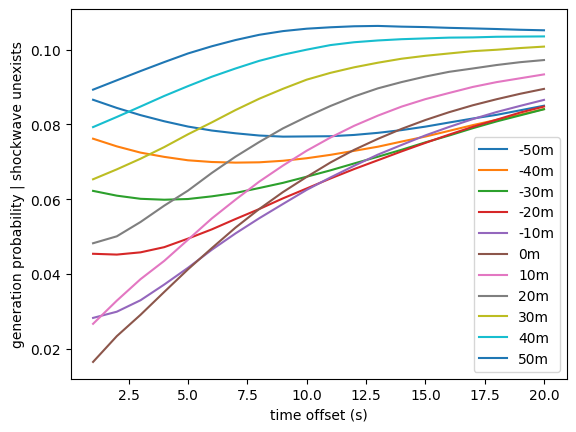

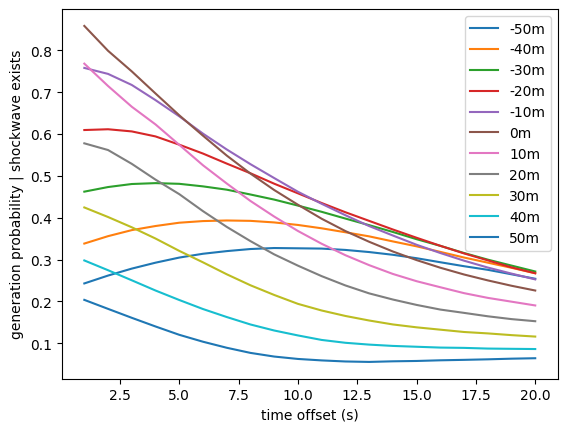

-4 -3


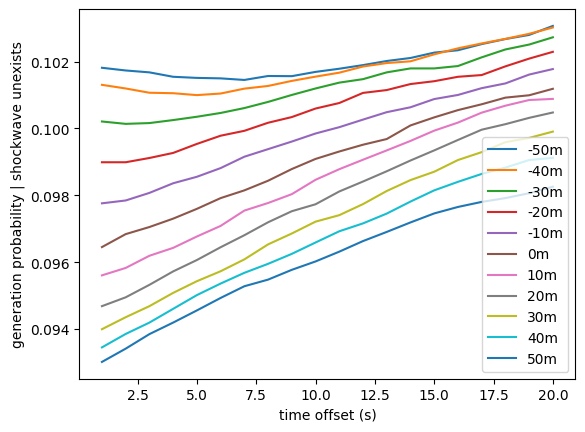

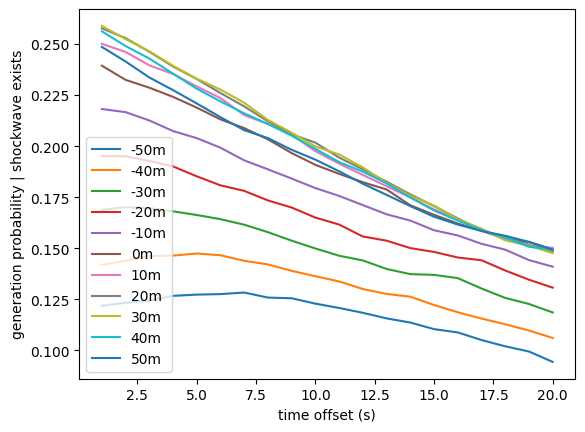

-3 -4


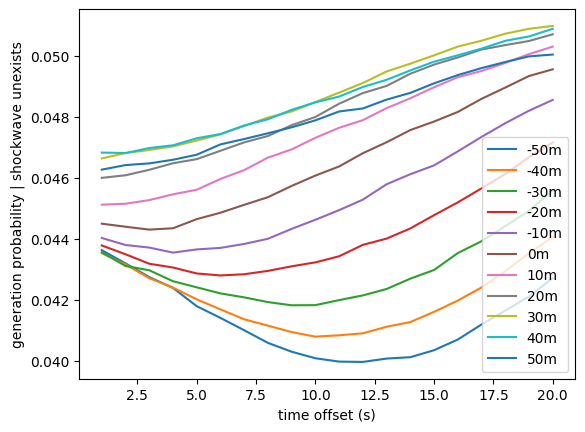

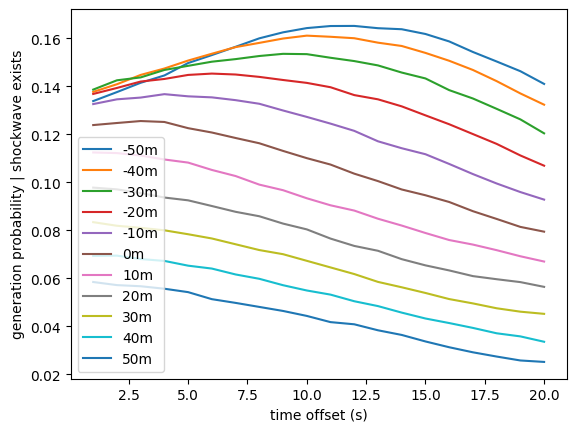

-4 -4


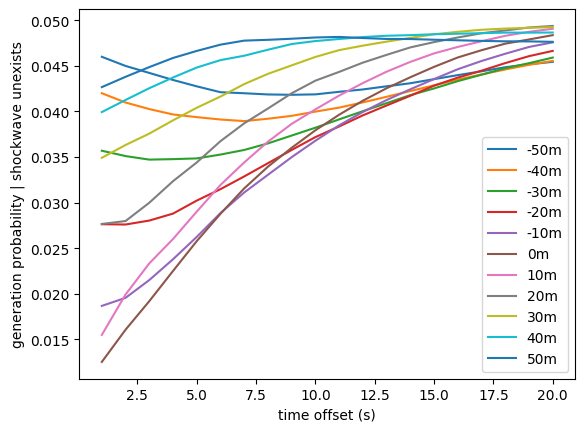

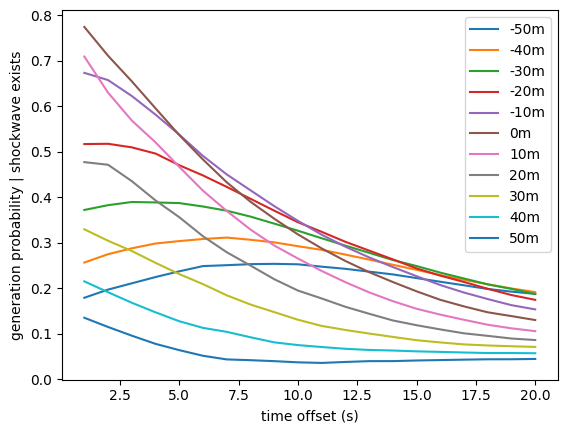

-5 -4


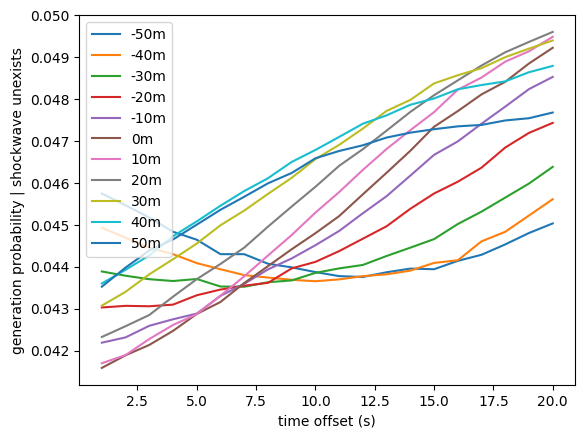

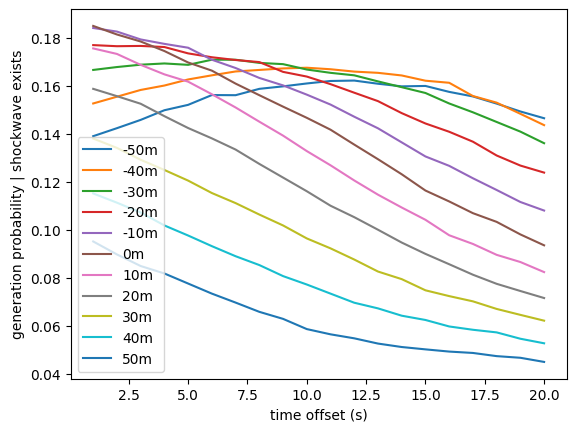

-4 -5


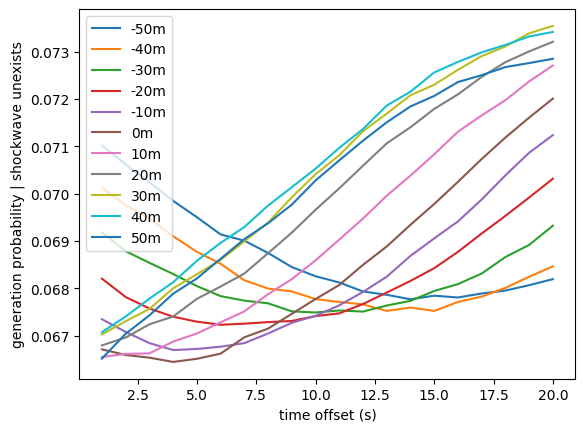

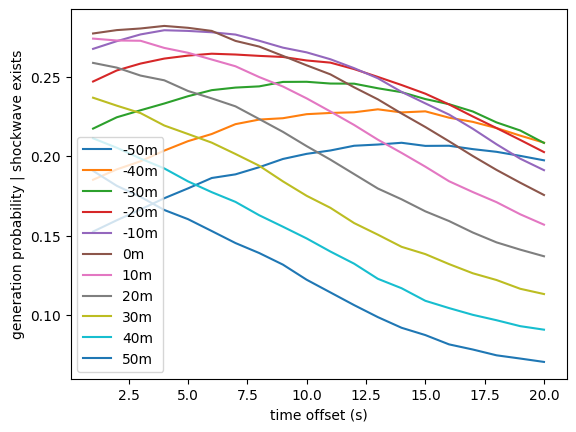

-5 -5


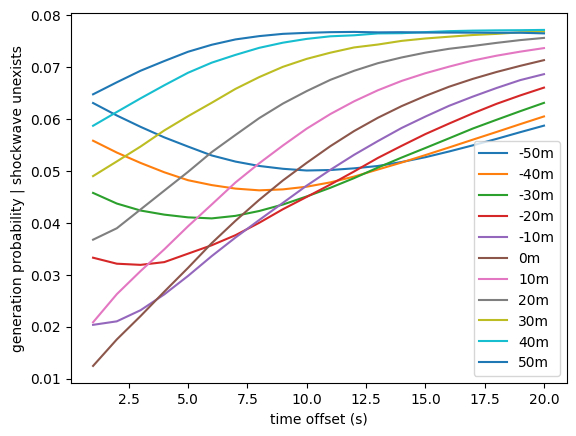

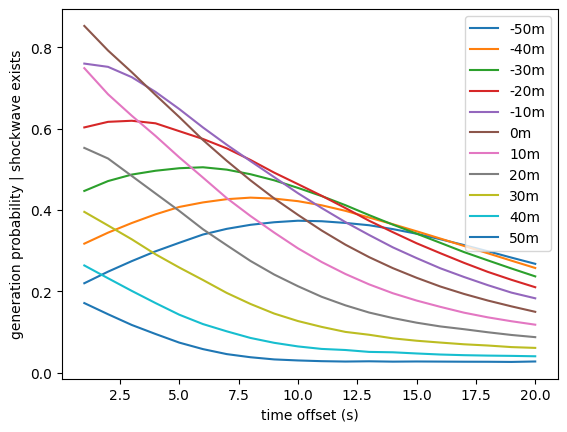

In [ ]:
# Different Lanes
lane0s=[-3, -4, -3, -4, -5, -4, -5 ]
lane1s=[-3, -3, -4, -4, -4, -5, -5  ]
for la in range(len(lane0s)):
  lane0=lane0s[la]
  lane1=lane1s[la]

  wave_gen_probs=[]
  wave_con_probs=[]
  print(lane0, lane1)
  for x_offset in range(-max_x_offset,max_x_offset+1):
    wave_gen_probs.append([])
    wave_con_probs.append([])
    for t_offset in range(1, max_t_offset+1):

    #print("x and t shift", x_offset*x_wd, t_offset*t_wd)


      #wave_gen_prob=[]
      #wave_con_prob=[]
      #print("lane", lane)


      current_state=new_wave_binary[lane0][ max_x_offset:-max_x_offset-1 , 0:-max_t_offset-1]
      future_state=new_wave_binary[lane1][ max_x_offset+x_offset: -max_x_offset-1+x_offset , t_offset:-max_t_offset-1+t_offset ]
      # current no wave, future wave
      wave01=sum(sum((current_state==0)*(future_state==1)*1))
      # current wave, future wave
      wave11=sum(sum((current_state==1)*(future_state==1)*1))
      # current no wave, future no wave
      wave00=sum(sum((current_state==0)*(future_state==0)*1))
      # current wave, future no wave
      wave10=sum(sum((current_state==1)*(future_state==0)*1))
      #print("Wave generation prob", wave01/ (wave00+wave01) )
      #print("Wave continuation prob", wave11/ (wave11+wave10) )

      #wave_gen_probs[x_offset][t_offset].append(wave01/ (wave00+wave01))
      #wave_con_probs[x_offset][t_offset].append(wave11/ (wave11+wave10))
      wave_gen_probs[-1].append(wave01/ (wave00+wave01) )
      wave_con_probs[-1].append(wave11/ (wave11+wave10))

  for i in range(len(wave_gen_probs)):
    #print((-max_x_offset+i)*x_wd)
    #print(wave_gen_probs[i])
    plt.plot([t_offset for t_offset in range(1, max_t_offset+1)], wave_gen_probs[i])
    #print()
  plt.legend([str(x_offset*x_wd)+"m" for x_offset in range(-max_x_offset,max_x_offset+1)])
  #plt.ylim(0,0.14)
  plt.xlabel("time offset (s)")
  plt.ylabel("generation probability | shockwave unexists")
  plt.show()

  for i in range(len(wave_con_probs)):
    #print((-max_x_offset+i)*x_wd)
    #print(wave_gen_probs[i])
    plt.plot([t_offset for t_offset in range(1, max_t_offset+1)], wave_con_probs[i])
    #print()
  plt.legend([str(x_offset*x_wd)+"m" for x_offset in range(-max_x_offset,max_x_offset+1)])
  #plt.ylim(0, 1)
  plt.xlabel("time offset (s)")
  plt.ylabel("generation probability | shockwave exists")
  plt.show()

In [ ]:
# extract lane change information
lc_infos=[]
for la in range(len(lane0s)):
  lane0=lane0s[la]
  lane1=lane1s[la]
  rel_lcs=lc_df[(lc_df["old_lane"]==lane0) & (lc_df["new_lane"]==lane1)]
  lc_info=np.zeros((len(current_state), len(current_state[0])))
  for x_idx in range(len(current_state)):
    print(x_idx)#, t_idx)
    x0=min_x+(max_x_offset+x_idx)*x_wd
    x1=min_x+(max_x_offset+x_idx+x_offset)*x_wd
    #rel_lcs_x=rel_lcs[(rel_lcs["location"]>=min(x0,x1)) & (rel_lcs["location"]<=max(x0,x1)) ]
    rel_lcs_x=rel_lcs[(rel_lcs["location"]>=x0-25) & (rel_lcs["location"]<=x0+25) ]

    for t_idx in range(0, len(current_state[x_idx])):

      t0=min_t+(t_idx)*t_wd
      t1=min_t+(t_idx+t_offset)*t_wd
      #rel_lcs_t=rel_lcs_x[(rel_lcs_x["time"]>=t0) & (rel_lcs_x["time"]<=t1) ]
      rel_lcs_t=rel_lcs_x[(rel_lcs_x["time"]>=t0-20) & (rel_lcs_x["time"]<=t0) ]
      lc_num=min(len(rel_lcs_t),1)
      lc_info[x_idx][t_idx]=lc_num

  lc_infos.append(lc_info)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31


In [ ]:
for la in range(len(lane0s)):
  lane0=lane0s[la]
  lane1=lane1s[la]
  lc_info=lc_infos[la]
  pd.DataFrame(lc_info).to_csv('/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_lc3'+str(lane0)+'to'+str(lane1)+'.csv', index=False, header=False)

In [ ]:
lc_infos={}
for la in range(len(lane0s)):
  lane0=lane0s[la]
  lane1=lane1s[la]
  lc_infos[la]=pd.read_csv('/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395_lc3'+str(lane0)+'to'+str(lane1)+'.csv',header=None).to_numpy()

In [ ]:
# lane change intensity included
# the impact of lane change on the probabilities
lane0=-3
lane1=-4
x_offset=-3
t_offset=6

rel_lcs=lc_df[(lc_df["old_lane"]==lane0) & (lc_df["new_lane"]==lane1)]

current_state=new_wave_binary[lane0][ max_x_offset:-max_x_offset-1 , 0:-max_t_offset-1]
future_state=new_wave_binary[lane1][ max_x_offset+x_offset: -max_x_offset-1+x_offset , t_offset:-max_t_offset-1+t_offset ]
# lane changes
w01s=[]
w10s=[]
w11s=[]
w00s=[]

for x_idx in range(len(current_state)):
  print(x_idx)#, t_idx)
  x0=min_x+(max_x_offset+x_idx)*x_wd
  x1=min_x+(max_x_offset+x_idx+x_offset)*x_wd
  #rel_lcs_x=rel_lcs[(rel_lcs["location"]>=min(x0,x1)) & (rel_lcs["location"]<=max(x0,x1)) ]
  rel_lcs_x=rel_lcs[(rel_lcs["location"]>=x0-20) & (rel_lcs["location"]<=x0+20) ]

  for t_idx in range(0, len(current_state[x_idx]), 10):

    t0=min_t+(t_idx)*t_wd
    t1=min_t+(t_idx+t_offset)*t_wd
    #rel_lcs_t=rel_lcs_x[(rel_lcs_x["time"]>=t0) & (rel_lcs_x["time"]<=t1) ]
    rel_lcs_t=rel_lcs_x[(rel_lcs_x["time"]>=t0-10) & (rel_lcs_x["time"]<=t0+10) ]


    lc_num=min(len(rel_lcs_t),1)

    lc_ins.append(lc_num)

    cur_state=new_wave_binary[lane0][max_x_offset+x_idx][t_idx]
    fut_state=new_wave_binary[lane1][max_x_offset+x_idx+x_offset][t_idx+t_offset]

    if cur_state==0 and fut_state==1:
      w01s.append(1)
      w10s.append(0)
      w11s.append(0)
      w00s.append(0)

    if cur_state==1 and fut_state==1:
      w01s.append(0)
      w10s.append(0)
      w11s.append(1)
      w00s.append(0)

    if cur_state==1 and fut_state==0:
      w01s.append(0)
      w10s.append(1)
      w11s.append(0)
      w00s.append(0)

    if cur_state==0 and fut_state==0:
      w01s.append(0)
      w10s.append(0)
      w11s.append(0)
      w00s.append(1)



0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31


In [ ]:
lc_infos[0]==

SyntaxError: invalid syntax (<ipython-input-32-4e638b42f272>, line 1)

-4 -3


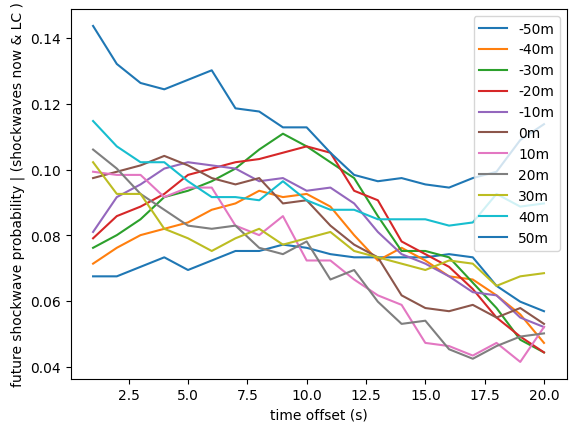

-3 -4


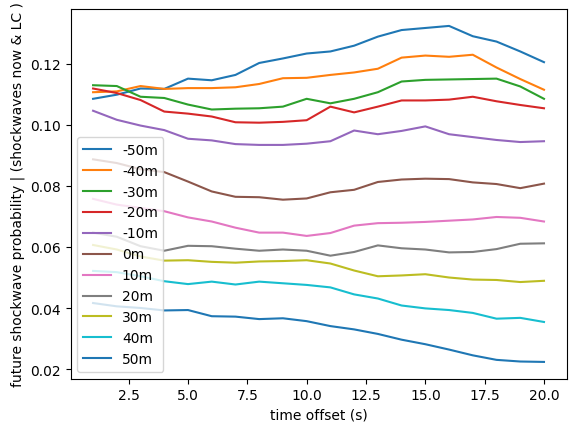

-5 -4


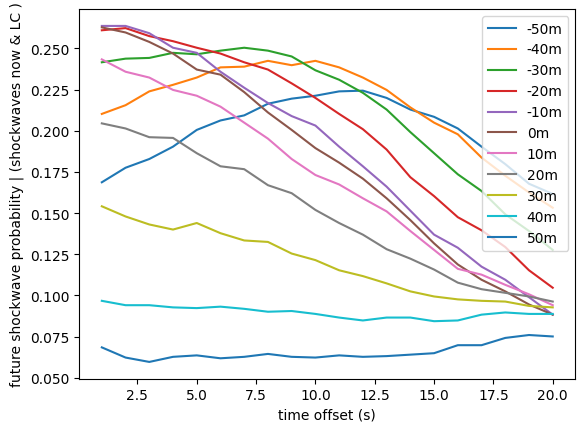

-4 -5


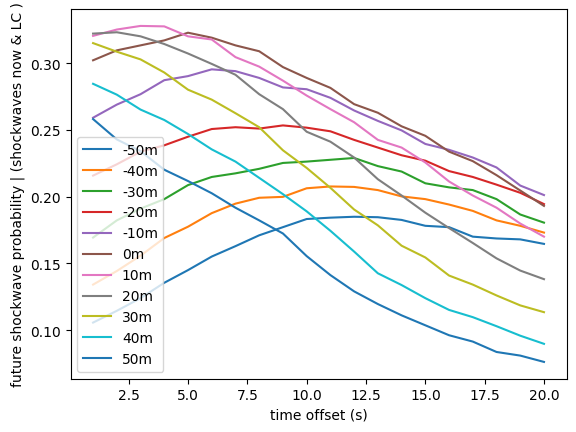

In [ ]:
# for each lc level, check the chnage of shockwave formation given
# loop over all numbers of lcs, all pairs of lanes, and all position-time shifts
for la in range(len(lane0s)):
  lane0=lane0s[la]
  lane1=lane1s[la]
  lc_info=lc_infos[la]
  if lane0==lane1:
    continue
  print(lane0, lane1)

  for x_offset in range(-max_x_offset,max_x_offset+1):
    wave_gen_lc_probs=[]
    wave_con_lc_probs=[]
    wave_gen_nlc_probs=[]
    wave_con_nlc_probs=[]
    #print(x_offset)

    for t_offset in range(1, max_t_offset+1):
      #print(x_offset, t_offset)

      current_state=new_wave_binary[lane0][ max_x_offset:-max_x_offset-1 , 0:-max_t_offset-1]
      future_state=new_wave_binary[lane1][ max_x_offset+x_offset: -max_x_offset-1+x_offset , t_offset:-max_t_offset-1+t_offset ]

      wave01_nlc=sum(sum((current_state==0)*(future_state==1)*(lc_info==0)*1))
      # current wave, future wave
      wave11_nlc=sum(sum((current_state==1)*(future_state==1)*(lc_info==0)*1))
      # current no wave, future no wave
      wave00_nlc=sum(sum((current_state==0)*(future_state==0)*(lc_info==0)*1))
      # current wave, future no wave
      wave10_nlc=sum(sum((current_state==1)*(future_state==0)*(lc_info==0)*1))

      wave01_lc=sum(sum((current_state==0)*(future_state==1)*(lc_info>=1)*1))
      # current wave, future wave
      wave11_lc=sum(sum((current_state==1)*(future_state==1)*(lc_info>=1)*1))
      # current no wave, future no wave
      wave00_lc=sum(sum((current_state==0)*(future_state==0)*(lc_info>=1)*1))
      # current wave, future no wave
      wave10_lc=sum(sum((current_state==1)*(future_state==0)*(lc_info>=1)*1))

      wave_gen_lc_prob=wave01_lc/ (wave00_lc+wave01_lc)
      wave_con_lc_prob=wave11_lc/ (wave11_lc+wave10_lc)
      wave_gen_nlc_prob=wave01_nlc/ (wave00_nlc+wave01_nlc)
      wave_con_nlc_prob=wave11_nlc/ (wave11_nlc+wave10_nlc)

      #print("wave_gen_lc", wave_gen_lc_prob)
      #print("wave_gen_nlc", wave_gen_nlc_prob)
      #print("wave_con_lc", wave_con_lc_prob)
      #print("wave_con_nlc", wave_con_nlc_prob)

      wave_gen_lc_probs.append(wave_gen_lc_prob)
      wave_con_lc_probs.append(wave_con_lc_prob)
      wave_gen_nlc_probs.append(wave_gen_nlc_prob)
      wave_con_nlc_probs.append(wave_con_nlc_prob)

    t_offsets=[t_offset for t_offset in range(1, max_t_offset+1)]
    #plt.plot(t_offsets, wave_gen_lc_probs)
    #plt.plot(t_offsets, wave_gen_nlc_probs)

    plt.plot(t_offsets, wave_con_lc_probs)
    #plt.plot(t_offsets, wave_con_nlc_probs)

  #plt.legend(["gen lc", "gen nlc", "con lc", "con nlc"])
  plt.legend([str(x_offset*x_wd)+"m" for x_offset in range(-max_x_offset,max_x_offset+1)])
  plt.ylabel("future shockwave probability | (shockwaves now & LC )")
  plt.xlabel("time offset (s)")
  plt.show()



16678
5658


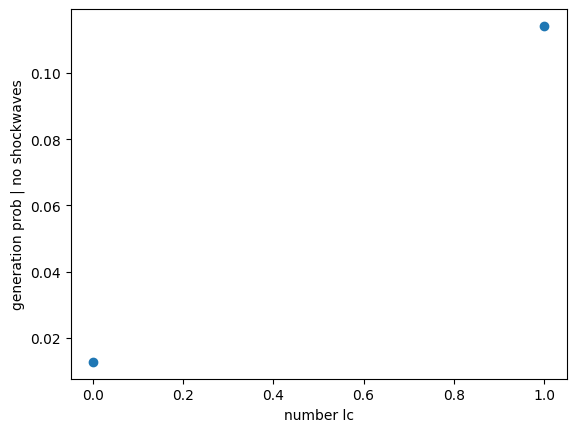

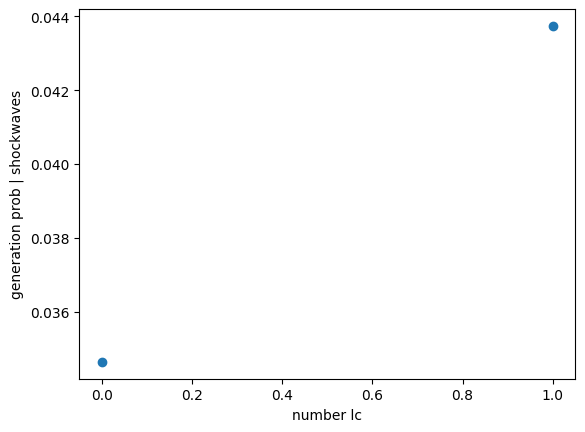

In [ ]:
lc_ins=np.array(lc_ins)
w01s=np.array(w01s)
w10s=np.array(w10s)
w11s=np.array(w11s)
w00s=np.array(w00s)

lc_nums=list(set(lc_ins))
con_probs=[]
gen_probs=[]
for lc_num in lc_nums:
  print(sum(lc_ins==lc_num))
  from1=w11s[((w11s==1)*1+(w10s==1)*1==1) & lc_ins==lc_num]
  if len(from1)!=0:
    con_prob=sum(from1)/len(from1)
  else:
    con_prob=0

  con_probs.append(con_prob)

  from0=w01s[((w01s==1)*1+(w00s==1)*1==1) & lc_ins==lc_num]
  if len(from0)!=0:
    gen_prob=sum(from0)/len(from0)
  else:
    gen_prob=0

  gen_probs.append(gen_prob)

plt.scatter(lc_nums, con_probs)
plt.xlabel("number lc")
plt.ylabel("generation prob | no shockwaves")
plt.show()

plt.scatter(lc_nums, gen_probs)
plt.xlabel("number lc")
plt.ylabel("generation prob | shockwaves")
plt.show()

In [ ]:
len(current_state)

32

[0       False
 1       False
 2       False
 3        True
 4       False
         ...  
 4078    False
 4079    False
 4080     True
 4081     True
 4082    False
 Length: 4083, dtype: bool]

In [ ]:
lc_df

,Unnamed: 0.1,Unnamed: 0,ID,time,location,old_lane,new_lane,MLC
0,0,0,34,337.5,27.015579,-4,-5,1
1,1,1,34,337.8,30.016180,-5,-4,0
2,2,2,34,337.9,31.016254,-4,-5,1
3,3,3,71,844.4,21.014378,-3,-4,1
4,4,4,71,847.6,48.017724,-4,-5,1
...,...,...,...,...,...,...,...,...
4078,4078,4078,10575,7129.3,97.019289,-4,-5,0
4079,4079,4079,10577,7141.7,354.030118,-4,-3,0
4080,4080,4080,10577,7145.0,442.039393,-3,-4,0
4081,4081,4081,10616,4293.5,364.030734,-3,-4,0


array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [ ]:
(current_state==future_state)*1

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [ ]:
-max_x_offset-1+x_offset

-1

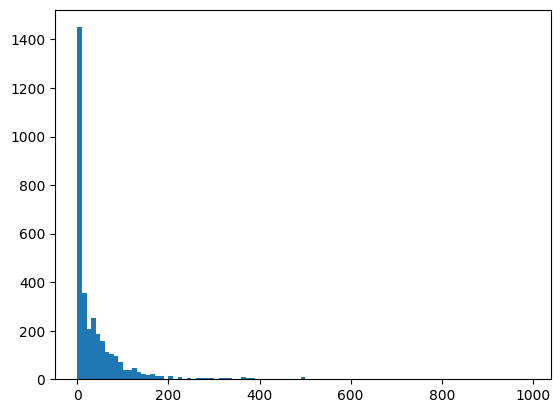

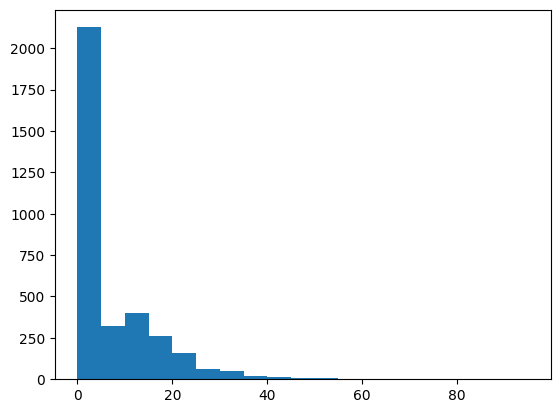

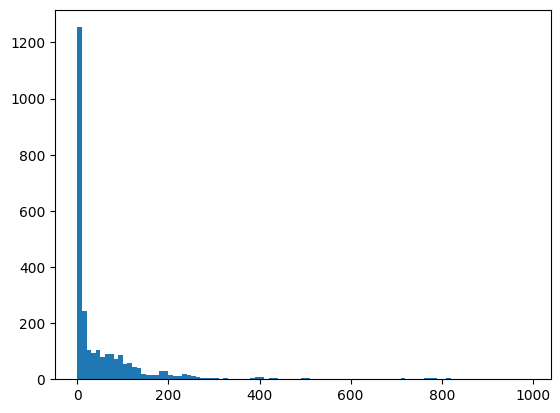

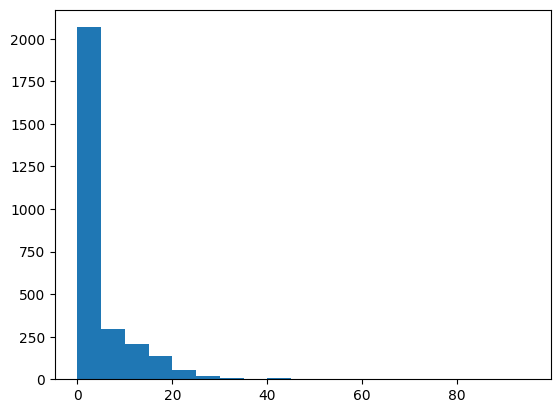

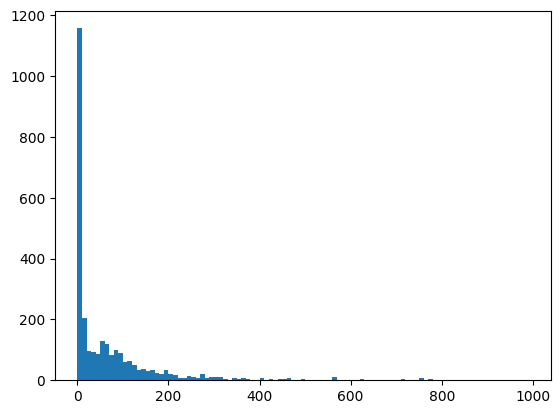

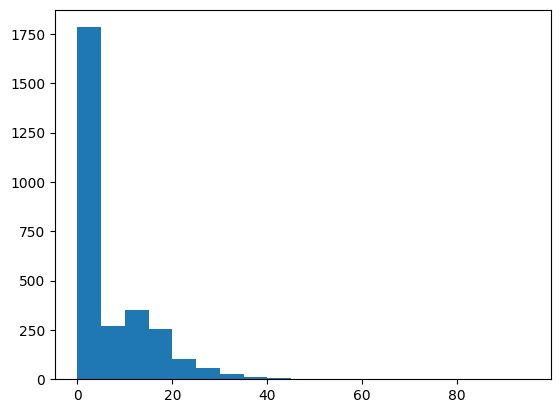

In [ ]:
for lane in lanes:
  intervals=[] # how far apart do the shockwaves arrive
  durations=[] # how long do the shockwaves stay at the same location
  for x_idx in range(len(new_wave_binary[lane])):
    lane_locs1=new_wave_binary[lane][x_idx][1:]
    lane_locs0=new_wave_binary[lane][x_idx][:-1]
    wave_change=lane_locs1-lane_locs0
    wave_start_idxes=np.where(wave_change==1)[0]
    wave_end_idxes=np.where(wave_change==-1)[0]
    # check the durarion
    for start_idx in wave_start_idxes:
      rel_end_idxes=wave_end_idxes[wave_end_idxes>start_idx]
      if len(rel_end_idxes)>0:
        durations.append(min(rel_end_idxes-start_idx)*t_wd)
    for end_idx in wave_end_idxes:
      rel_start_idxes=wave_start_idxes[wave_start_idxes>end_idx]
      if len(rel_start_idxes)>0:
        intervals.append(min(rel_start_idxes-end_idx)*t_wd)
  plt.hist(intervals, bins=[i*10 for i in range(0,100)])
  plt.show()
  plt.hist(durations, bins=[i*5 for i in range(0,20)])
  plt.show()


In [ ]:
wave_start_idx

array([ 672,  675,  767,  846,  854,  862,  865,  981,  995,  999, 1072,
       1075, 1094, 1308, 1310, 1693, 1697, 1700, 1705, 1824, 1828, 1831,
       1839, 1841, 1844, 1847, 2054, 2061, 2072, 2074, 2077, 2092, 2150,
       2153, 2159, 2162, 2166, 2170, 2250, 2253, 2256, 2258, 2260, 2265,
       2411, 2415, 3255, 3259, 3265, 3438, 3440, 3443, 3449, 3467, 4426,
       4434, 4436, 4702, 4705, 4710, 4714, 5469, 5518, 5520, 5539, 5549,
       6112, 6117, 6120, 6124, 6481, 6491, 6494, 6501, 6804, 6810])

In [ ]:
wave_end_idx

array([ 673,  696,  768,  847,  857,  863,  866,  993,  998, 1002, 1074,
       1090, 1116, 1309, 1325, 1694, 1698, 1702, 1710, 1826, 1829, 1833,
       1840, 1842, 1846, 1857, 2058, 2063, 2073, 2076, 2078, 2093, 2151,
       2154, 2160, 2164, 2167, 2174, 2251, 2254, 2257, 2259, 2261, 2275,
       2413, 2431, 3256, 3262, 3269, 3439, 3441, 3447, 3466, 3468, 4428,
       4435, 4437, 4703, 4707, 4712, 4716, 5478, 5519, 5521, 5540, 5550,
       6113, 6118, 6121, 6125, 6482, 6493, 6495, 6502, 6805, 6811])

In [ ]:
# lc_dictionary:


In [ ]:
wave_binary[-3][0]

array([0., 0., 0., ..., 0., 0., 0.])

## Analyze Wave Heatplot

In [ ]:
# check wave speed across the same lane

In [ ]:
sum(sum(wave_binary[-3]))

NameError: name 'wave_binary' is not defined

In [ ]:
for lane in lanes:
  print(lane)
  wave_data=wave_binary[lane]
  spd_freq=[]
  for t_shift in range(-30, 30):
    spd_freq.append(0)
    for loc in range(1, len(wave_data)):
      #print(loc)
      for t_val in range(30, len(wave_data[0])-30):
        if wave_data[loc][t_val]==1 and wave_data[loc-1][t_val+t_shift]==1:
          spd_freq[-1]=spd_freq[-1]+1
  plt.plot([i for i in range(-30,30)],spd_freq)
  plt.show()




10


NameError: name 'wave_binary' is not defined

{-10: 1,
 -9: 1,
 -8: 1,
 -7: 3,
 -6: 5,
 -5: 11,
 -4: 16,
 -3: 27,
 -2: 37,
 -1: 42,
 0: 38,
 1: 48,
 2: 44,
 3: 44,
 4: 37,
 5: 41,
 6: 35,
 7: 30,
 8: 23,
 9: 21}

## Merge

In [ ]:
'''
merge3_xs=[]
merge3_ts=[]
#lane_data=rel_data[( rel_data["lane-kf"]==lane)  ]
ids=rel_data["ID"].unique()
for ID in ids:
    veh=rel_data[rel_data["ID"]==ID]
    if veh["lane-kf"].values[0]==-3 and veh["dist_cntr"].values[0]>=200:
        merge3_xs.append(veh["dist_cntr"].values[0])
        merge3_ts.append(veh["time"].values[0])
#merge3_ts=[]
'''

'\nmerge3_xs=[]\nmerge3_ts=[]\n#lane_data=rel_data[( rel_data["lane-kf"]==lane)  ]\nids=rel_data["ID"].unique()\nfor ID in ids:\n    veh=rel_data[rel_data["ID"]==ID]\n    if veh["lane-kf"].values[0]==-3 and veh["dist_cntr"].values[0]>=200:\n        merge3_xs.append(veh["dist_cntr"].values[0])\n        merge3_ts.append(veh["time"].values[0])\n#merge3_ts=[]\n'

In [ ]:
#pd.DataFrame({"x": merge3_xs, "t": merge3_ts}).to_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395Merge3Loc.csv")

In [ ]:
merge3_data=pd.read_csv("/drive/MyDrive/Projects/Freeway_Project/TGSIM_Processed/I395Merge3Loc.csv")
merge3_xs=merge3_data["x"].values
merge3_ts=merge3_data["t"].values

# Longitudinal Visualization

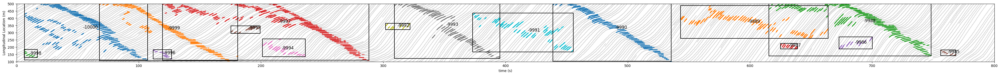

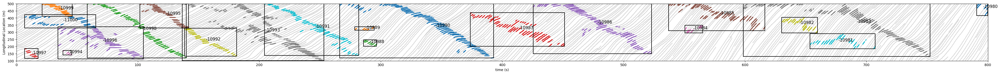

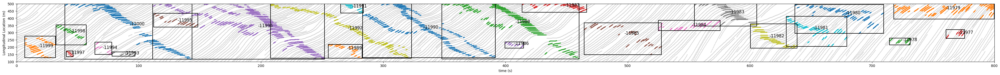

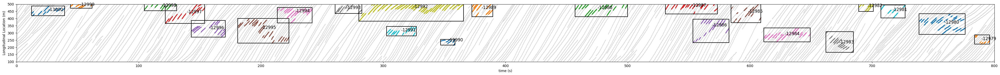

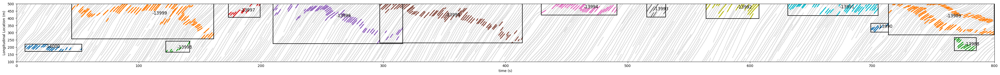

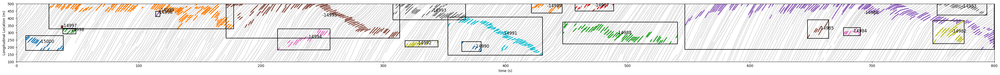

In [ ]:
# visualize 0 to 1000
new_cluster_ts_lane={}
new_cluster_xs_lane={}
shockwave_rectangles={}


for lane in lanes:
  shockwave_rectangles[lane]=[]
  plt.figure(figsize=(50, 3))
  lane_data=rel_data[( rel_data["lane-kf"]==lane) & ( rel_data["time"]<=8000)  ]
  plt.scatter(lane_data["time"], lane_data["dist_cntr"], s=0.2, color="lightgrey")
  for group in range(len(t_groups_lane[lane])):
        #print(group)
    t_vals=t_groups_lane[lane][group]
    x_vals=x_groups_lane[lane][group]
    min_gt=min(t_vals)
    max_gt=max(t_vals)
    min_gx=min(x_vals)
    max_gx=max(x_vals)

    plt.scatter(t_vals, x_vals, s=2)
    plt.plot([min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx], c="black")
    #plt.plot([min_gt, ])
    #if max_gt>1000:
      #continue



    plt.text(np.mean(t_vals), np.mean(x_vals), str(-lane*1000+group), fontsize=12)

  plt.xlim([0,800])
  plt.xlabel("time (s)")
  plt.ylabel("Longitudinal Location (m)")
  plt.ylim(100,500)
  plt.show()




KeyError: 10

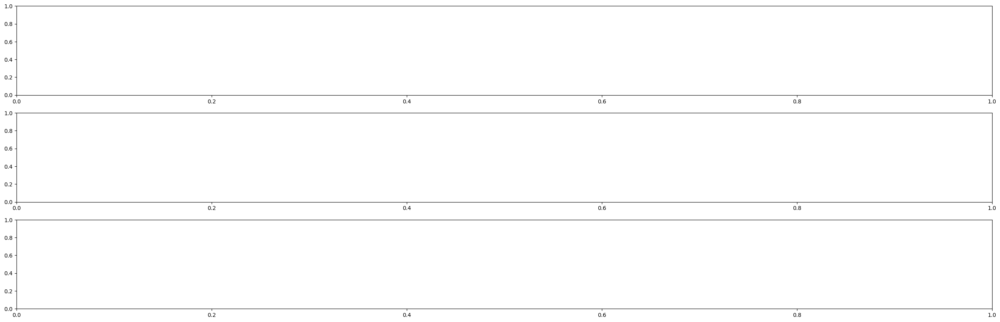

In [ ]:
# sift out some groups
# lcs into 3
new_cluster_ts_lane={}
new_cluster_xs_lane={}
shockwave_rectangles={-3:[], -4:[], -5:[]}
min_size=50
t_buff=10 # the buffer where we count even outside of the shockwave
x_buff=20

t_wd=20
x_wd=50
#x_wd0=

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(max_t//25,10))


ax_lanes={-3:ax1, -4:ax2, -5:ax3}
for lane in lanes:
    new_cluster_ts_lane[lane]=[]
    new_cluster_xs_lane[lane]=[]

    #plt.figure(figsize=(max_t//25,2.5))
    lane_data=rel_data[( rel_data["lane-kf"]==lane)  ]
    color_bar = np.maximum(np.minimum(lane_data["speed-kf"].values, 10*np.ones(len(lane_data))), 5*np.ones(len(lane_data)))
    ax_lanes[lane].scatter(lane_data["time"], lane_data["dist_cntr"], c=color_bar, cmap='RdYlGn',  s=0.01)
    for group in range(len(t_groups_lane[lane])):
        #print(group)
        t_vals=t_groups_lane[lane][group]
        x_vals=x_groups_lane[lane][group]
        min_gt=min(t_vals)
        max_gt=max(t_vals)
        min_gx=min(x_vals)
        max_gx=max(x_vals)

        if len(t_vals)<min_size:
            continue

        new_cluster_ts_lane[lane].append(t_vals)
        new_cluster_xs_lane[lane].append(x_vals)

        if len(t_vals)>100:
            ax_lanes[lane].scatter(t_vals, x_vals, s=2)
        #'''
        if lane==-3:
            shockwave_rectangles[lane].append([[min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx]])

            #ax_lanes[lane].plot([min_gt, max_gt+t_buff, max_gt+t_buff, min_gt, min_gt], [min_gx-x_buff, min_gx-x_buff, max_gx+x_buff, max_gx+x_buff, min_gx-x_buff], c="black")
            ax_lanes[lane].plot([min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx], c="grey")
        if lane==-4:

            shockwave_rectangles[lane].append([[min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx]])
            #ax_lanes[lane].plot([min_gt-t_wd, min_gt-t_wd, min_gt+t_buff, min_gt+t_buff, min_gt-t_wd ], [max_gx-x_wd, max_gx+x_wd, max_gx+x_wd, max_gx-x_wd, max_gx-x_wd ], c="black")

            ax_lanes[lane].plot([min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx], c="grey")
        if lane==-5:

            shockwave_rectangles[lane].append([[min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx]])
            ax_lanes[lane].plot([min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx], c="grey")
            #ax_lanes[lane+1].plot([min_gt, max_gt, max_gt, min_gt, min_gt], [min_gx, min_gx, max_gx, max_gx, min_gx], c="grey")
        #'''

        ax_lanes[lane].text(np.mean(t_vals), np.mean(x_vals), str(-lane*1000+group), fontsize=15)
        #plt.xticks([k*20 for k in range(0,int(max_t//20+1))])
        #plt.xticks([k*50 for k in range(0,81)])

    if lane==-3:

        lc_34=rel_lc_df[(rel_lc_df["old_lane"]==-3) & (rel_lc_df["new_lane"]==-4)]
        lc_43=rel_lc_df[(rel_lc_df["old_lane"]==-4) & (rel_lc_df["new_lane"]==-3)]
        ax_lanes[lane].scatter(lc_34["time"], lc_34["location"], marker="v", c="black", s=20)
        ax_lanes[lane].scatter(lc_43["time"], lc_43["location"], marker="^", c="black", s=20)
        ax_lanes[lane].scatter(merge3_ts, merge3_xs, c="black", s=10)

    if lane==-4:

        lc_54=rel_lc_df[(rel_lc_df["old_lane"]==-5) & (rel_lc_df["new_lane"]==-4)]
        lc_45=rel_lc_df[(rel_lc_df["old_lane"]==-4) & (rel_lc_df["new_lane"]==-5)]
        ax_lanes[lane].scatter(lc_34["time"], lc_34["location"], marker="^", c="black", s=20)
        ax_lanes[lane].scatter(lc_43["time"], lc_43["location"], marker="v", c="black", s=20)
        ax_lanes[lane].scatter(lc_54["time"], lc_54["location"], marker="2", c="black", s=30)
        ax_lanes[lane].scatter(lc_45["time"], lc_45["location"], marker="1", c="black", s=30)

    if lane==-5:

        ax_lanes[lane].scatter(lc_54["time"], lc_54["location"], marker="1", c="black", s=30)
        ax_lanes[lane].scatter(lc_45["time"], lc_45["location"], marker="2", c="black", s=30)

    ax_lanes[lane].set_xlim(-5,max_t+5)
    ax_lanes[lane].set_xticks([i*20 for i in range(0,max_t//20+1)])
    ax_lanes[lane].grid(True)

    ax_lanes[lane].set_ylabel("location (m) at lane"+str(lane))
    ax_lanes[lane].set_title("lane"+str(lane))


plt.xlabel("time (s)")
plt.show()

In [ ]:
# for lane -3, we do not analyze the locations above 200m because it is influenced by the onramp and may therefore introduce biased in modelling
# However, it would be the input for the other two lanes
# fixing a location range, the
# Every 50m
# the shockwave

# probability across lanes is weighted by lane changes
# Two sets of prameters for distribution: current lane and adjacent lane. both assume to have weibull distribution but different parameters
#


In [ ]:
# get some statistics on the durations of the shockwaves:
x_lows=[0, 50, 100, 150, 200, 250, 300, 350]
shockwave_durations={-3:[], -4:[], -5:[]}

for x_low in x_lows:
  print(x_low)

  x_high=x_low+50
  if lane==-3 and x_high>250:
    continue
  for lane in lanes:
    for group in range(len(t_groups_lane[lane])):

      t_vals=t_groups_lane[lane][group]
      x_vals=x_groups_lane[lane][group]

      t_vals=t_vals[(x_vals>=x_low)&(x_vals<x_high)]
      if len(t_vals)!=0:
        shockwave_durations[lane].append(max(t_vals)-min(t_vals))


0
50
100


KeyError: 10

(array([66., 48., 51., 64., 45., 31., 22., 21., 13., 12.,  6.,  5.,  3.,
         1.,  1.,  0.,  1.,  1.,  1.,  1.,  1.,  0.,  0.,  0.,  1.,  0.,
         0.,  0.,  0.]),
 array([  0.,   5.,  10.,  15.,  20.,  25.,  30.,  35.,  40.,  45.,  50.,
         55.,  60.,  65.,  70.,  75.,  80.,  85.,  90.,  95., 100., 105.,
        110., 115., 120., 125., 130., 135., 140., 145.]),
 <BarContainer object of 29 artists>)

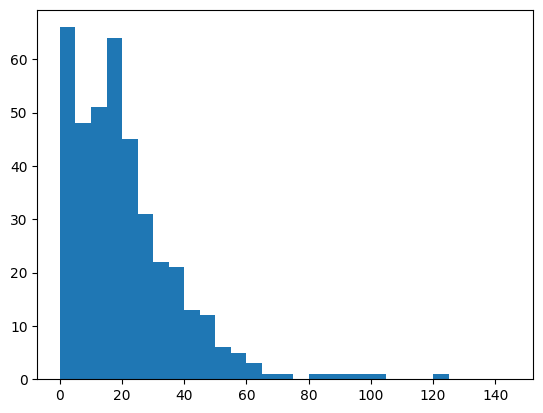

In [ ]:
plt.hist(shockwave_durations[-4], bins=[i*5 for i in range(0,30)])

# Lateral Visualization

In [ ]:
lanes

[-3, -4, -5]

In [ ]:
def mv_avg(times=None, xs=None, wd=5):
  times=np.array(times)
  xs=np.array(xs)
  new_ts=[]
  new_xs=[]
  for i in range(len(times)-wd+1):
    new_ts.append(times[i+int((wd+1)//2)])
    new_xs.append(np.average(xs[i:i+wd]))
  return np.array(new_ts), np.array(new_xs)

In [ ]:
x_lows=[100, 150, 200, 250, 300, 350, 400, 450]

In [ ]:
shockwave_start_times

{10: {100: array([  8. ,  95.2, 120. , 162.7, 229.4, 277.2, 386.3, 525.5, 743.7,
         763.8]),
  150: array([  6.3,  30.3, 111.7, 150.4, 206.8, 268.3, 374.8, 439.8, 512.6,
         627.4, 672.9, 734. , 756.1]),
  200: array([ 21.3, 140.4, 201.2, 258.3, 361.6, 434.7, 505.1, 625. , 674.1,
         724.8]),
  250: array([ 26.5, 108.4, 177.9, 214.8, 249.8, 340.1, 409.4, 493.4, 612.8,
         695. , 713.9]),
  300: array([ 14.9, 100.8, 175.4, 217.9, 301.9, 343.9, 378.5, 482.9, 605.8,
         669.4]),
  350: array([  9.1,  86.6, 161.6, 302.3, 341.9, 376.9, 467.3, 543.2, 669.1]),
  400: array([  6.5,  87.9, 121.5, 329.4, 373.2, 462.4, 543.9, 640.8]),
  450: array([ 16.1,  67.8, 119.3, 309.2, 438.7, 565.9, 615.5])},
 11: {100: array([ 11.2,  42.6,  84.1, 131.4, 176.7, 239.1, 273. , 385.5, 521.4,
         748.8]),
  150: array([  6.7,  38.2,  60.6, 118.8, 163.4, 223.9, 264.2, 362.7, 507.7,
         689.3, 737.3]),
  200: array([ 34.3, 109.7, 151.1, 193.4, 259.5, 285.8, 362.1, 427.9, 503. 

In [ ]:
# obtain the time intervals in each lane:
# whole site
#shockwave_start_times={-3:[], -4:[], -5:[]}
shockwave_start_times={10:{}, 11:{}, 12:{}, 13:{}, 14:{}, 15:{}}
for x_low in x_lows:
  print(x_low)

  x_high=x_low+50
  if lane==-3 and x_high>250:
    continue
  for lane in lanes:
    shockwave_start_times[lane][x_low]=[]
    for group in range(len(t_groups_lane[lane])):

      t_vals=t_groups_lane[lane][group]
      x_vals=x_groups_lane[lane][group]

      t_vals=t_vals[(x_vals>=x_low)&(x_vals<x_high)]
      #min_gt=min(t_vals)
      #max_gt=max(t_vals)
      #min_gx=min(x_vals)
      #max_gx=max(x_vals)
      if len(t_vals)>0:
        min_gt=min(t_vals)
        shockwave_start_times[lane][x_low].append(min_gt)

    shockwave_start_times[lane][x_low]=np.sort(shockwave_start_times[lane][x_low])
    '''
    params=ss.expon.fit(shockwave_start_times[lane][x_low][1:]-shockwave_start_times[lane][x_low][:-1], floc=0) # fit an exp distribution
    next_times=np.linspace(0,500, 10000)
    exp_dens=ss.expon.pdf(next_times, *params)

    print(params)
    plt.hist(shockwave_start_times[lane][x_low][1:]-shockwave_start_times[lane][x_low][:-1], bins=[i*10 for i in range(0,51)], density=True)
    plt.plot(next_times, exp_dens)

    plt.show()
    '''



100
150
200
250
300
350
400
450


From 10 to 11
[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909]
(0.0, 60.69999999999998)


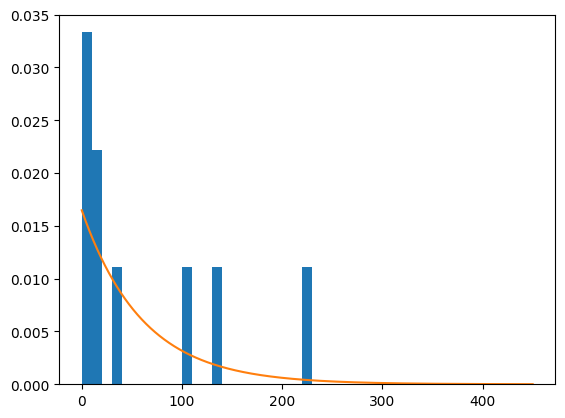

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545]
(0.0, 54.53809523809524)


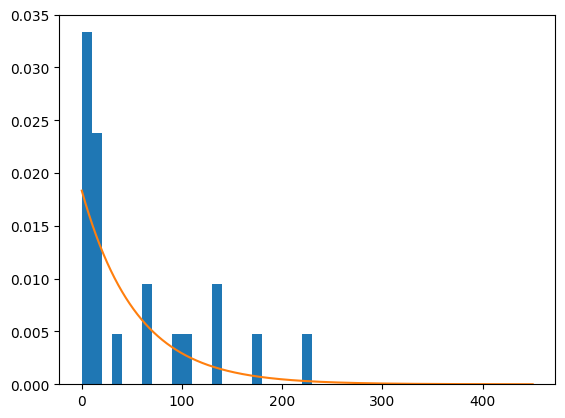

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5]
(0.0, 50.81666666666665)


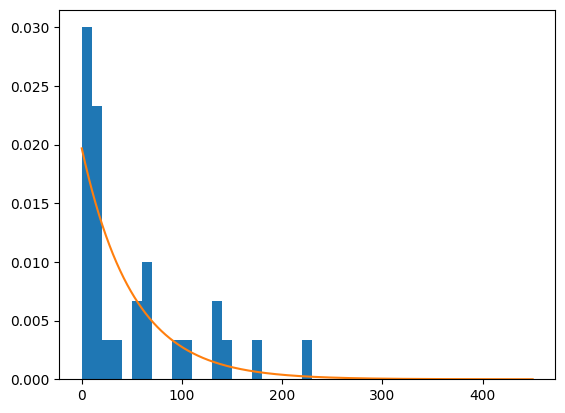

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5, 9.5, 33.599999999999994, 10.0, 37.69999999999999, 2.6999999999999886, 10.099999999999966, 4.900000000000034, 58.5, 45.40000000000009, 15.100000000000023]
(0.0, 43.8)


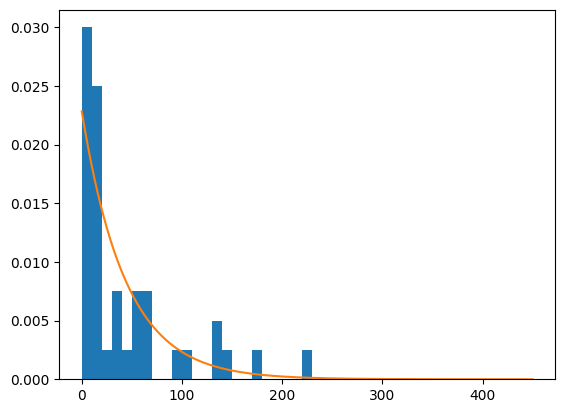

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5, 9.5, 33.599999999999994, 10.0, 37.69999999999999, 2.6999999999999886, 10.099999999999966, 4.900000000000034, 58.5, 45.40000000000009, 15.100000000000023, 7.200000000000001, 33.10000000000001, 58.19999999999999, 15.699999999999989, 42.10000000000002, 0.10000000000002274, 16.899999999999977, 67.5, 41.40000000000009, 34.39999999999998]
(0.0, 41.372)


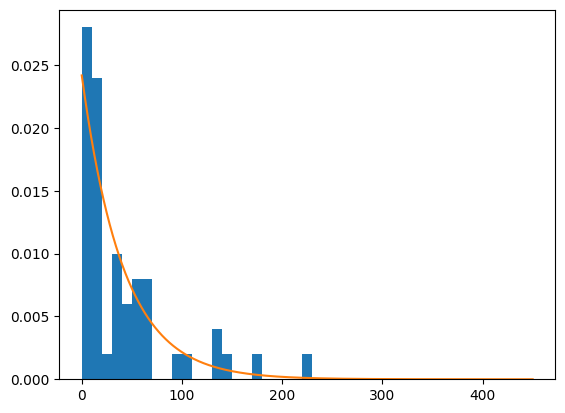

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5, 9.5, 33.599999999999994, 10.0, 37.69999999999999, 2.6999999999999886, 10.099999999999966, 4.900000000000034, 58.5, 45.40000000000009, 15.100000000000023, 7.200000000000001, 33.10000000000001, 58.19999999999999, 15.699999999999989, 42.10000000000002, 0.10000000000002274, 16.899999999999977, 67.5, 41.40000000000009, 34.39999999999998, 1.4000000000000004, 3.700000000000003, 67.80000000000001, 33.89999999999998, 34.10000000000002, 95.70000000000005, 5.300000000000011, 19.799999

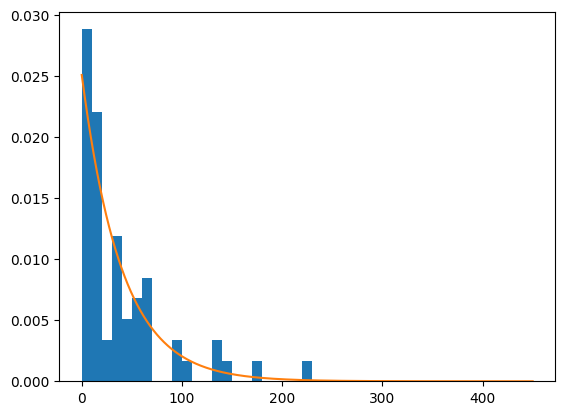

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5, 9.5, 33.599999999999994, 10.0, 37.69999999999999, 2.6999999999999886, 10.099999999999966, 4.900000000000034, 58.5, 45.40000000000009, 15.100000000000023, 7.200000000000001, 33.10000000000001, 58.19999999999999, 15.699999999999989, 42.10000000000002, 0.10000000000002274, 16.899999999999977, 67.5, 41.40000000000009, 34.39999999999998, 1.4000000000000004, 3.700000000000003, 67.80000000000001, 33.89999999999998, 34.10000000000002, 95.70000000000005, 5.300000000000011, 19.799999

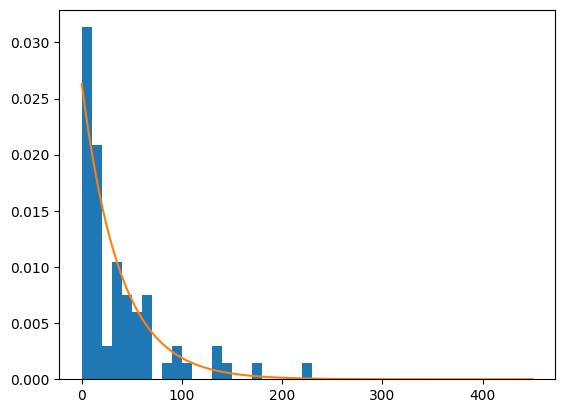

[3.1999999999999993, 36.2, 11.400000000000006, 14.0, 9.699999999999989, 108.30000000000001, 135.09999999999997, 223.29999999999995, 5.099999999999909, 0.40000000000000036, 7.900000000000002, 7.099999999999994, 13.0, 17.099999999999994, 94.39999999999998, 132.89999999999998, 67.89999999999998, 176.69999999999993, 61.89999999999998, 16.399999999999977, 3.2999999999999545, 12.999999999999996, 10.699999999999989, 58.30000000000001, 1.1999999999999886, 0.5, 68.30000000000001, 148.29999999999995, 28.399999999999977, 50.5, 9.5, 33.599999999999994, 10.0, 37.69999999999999, 2.6999999999999886, 10.099999999999966, 4.900000000000034, 58.5, 45.40000000000009, 15.100000000000023, 7.200000000000001, 33.10000000000001, 58.19999999999999, 15.699999999999989, 42.10000000000002, 0.10000000000002274, 16.899999999999977, 67.5, 41.40000000000009, 34.39999999999998, 1.4000000000000004, 3.700000000000003, 67.80000000000001, 33.89999999999998, 34.10000000000002, 95.70000000000005, 5.300000000000011, 19.799999

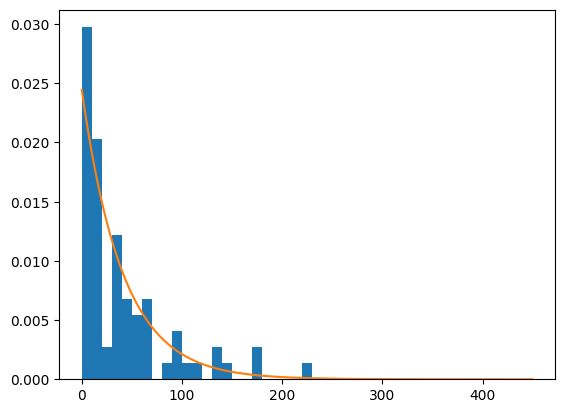

From 11 to 10
[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0]
(0.0, 29.390000000000004)


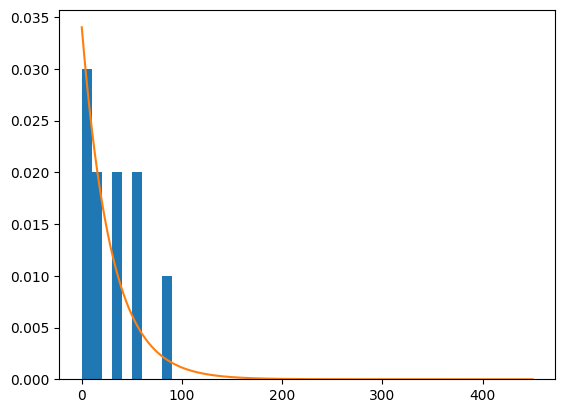

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068]
(0.0, 30.76666666666668)


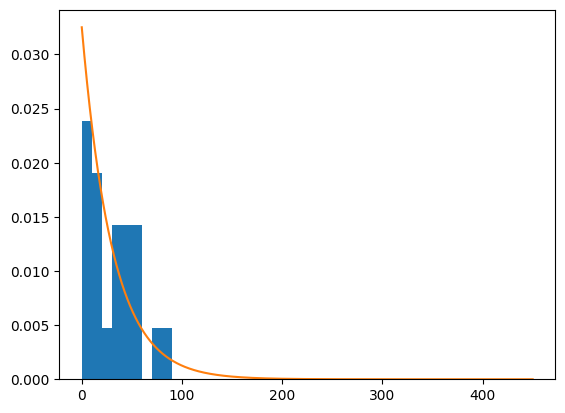

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318]
(0.0, 35.03437500000001)


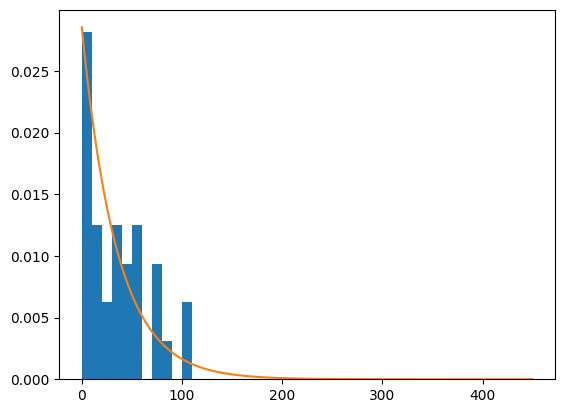

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318, 72.4, 4.1000000000000085, 35.900000000000006, 26.900000000000006, 87.60000000000002, 59.19999999999999, 79.09999999999997, 27.399999999999977, 60.89999999999998, 36.799999999999955, 21.200000000000045, 3.7999999999999545]
(0.0, 37.190909090909095)


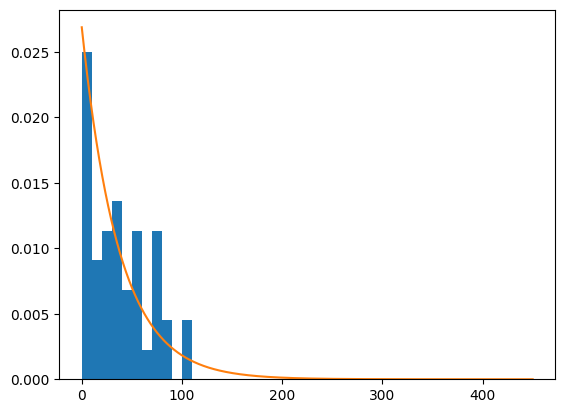

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318, 72.4, 4.1000000000000085, 35.900000000000006, 26.900000000000006, 87.60000000000002, 59.19999999999999, 79.09999999999997, 27.399999999999977, 60.89999999999998, 36.799999999999955, 21.200000000000045, 3.7999999999999545, 78.69999999999999, 66.69999999999999, 4.700000000000003, 41.5, 37.099999999999994, 7.200000000000017, 68.29999999999998, 23.399999999999977, 34.5, 87.5, 17.099999999999966, 55.39999999999998, 1.599999999999909, 22.199999999999932]


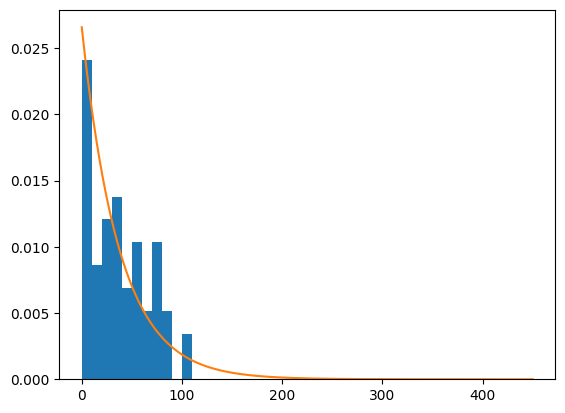

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318, 72.4, 4.1000000000000085, 35.900000000000006, 26.900000000000006, 87.60000000000002, 59.19999999999999, 79.09999999999997, 27.399999999999977, 60.89999999999998, 36.799999999999955, 21.200000000000045, 3.7999999999999545, 78.69999999999999, 66.69999999999999, 4.700000000000003, 41.5, 37.099999999999994, 7.200000000000017, 68.29999999999998, 23.399999999999977, 34.5, 87.5, 17.099999999999966, 55.39999999999998, 1.599999999999909, 22.199999999999932, 

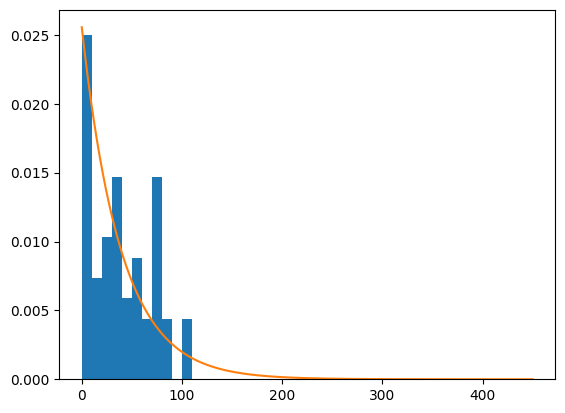

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318, 72.4, 4.1000000000000085, 35.900000000000006, 26.900000000000006, 87.60000000000002, 59.19999999999999, 79.09999999999997, 27.399999999999977, 60.89999999999998, 36.799999999999955, 21.200000000000045, 3.7999999999999545, 78.69999999999999, 66.69999999999999, 4.700000000000003, 41.5, 37.099999999999994, 7.200000000000017, 68.29999999999998, 23.399999999999977, 34.5, 87.5, 17.099999999999966, 55.39999999999998, 1.599999999999909, 22.199999999999932, 

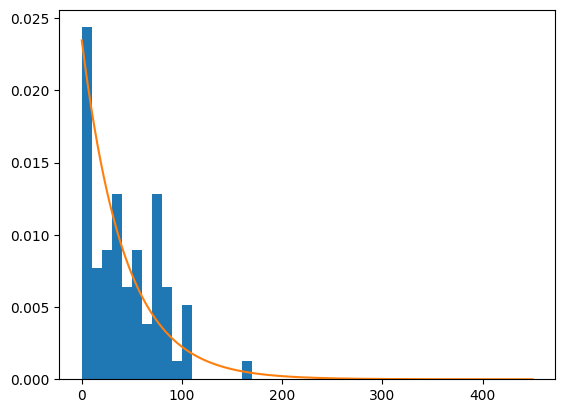

[84.0, 52.6, 11.100000000000009, 31.299999999999983, 52.70000000000002, 38.099999999999994, 4.199999999999989, 0.8000000000000114, 4.100000000000023, 15.0, 23.6, 73.5, 51.1, 31.60000000000001, 43.400000000000006, 44.400000000000006, 4.100000000000023, 12.100000000000023, 4.900000000000034, 44.700000000000045, 18.800000000000068, 106.10000000000001, 30.700000000000003, 50.099999999999994, 7.799999999999983, 102.10000000000002, 75.80000000000001, 72.59999999999997, 6.800000000000011, 2.1000000000000227, 20.700000000000045, 0.1999999999999318, 72.4, 4.1000000000000085, 35.900000000000006, 26.900000000000006, 87.60000000000002, 59.19999999999999, 79.09999999999997, 27.399999999999977, 60.89999999999998, 36.799999999999955, 21.200000000000045, 3.7999999999999545, 78.69999999999999, 66.69999999999999, 4.700000000000003, 41.5, 37.099999999999994, 7.200000000000017, 68.29999999999998, 23.399999999999977, 34.5, 87.5, 17.099999999999966, 55.39999999999998, 1.599999999999909, 22.199999999999932, 

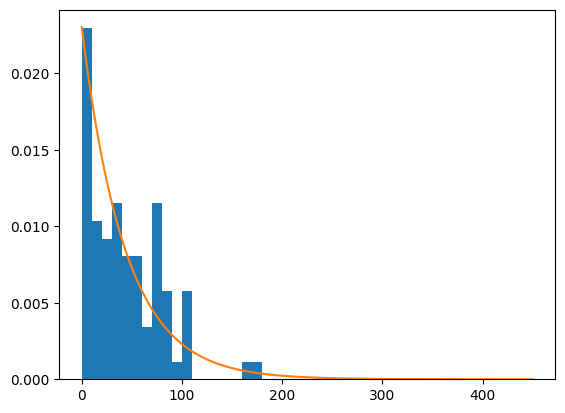

From 11 to 12
[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001]
(0.0, 18.78750000000001)


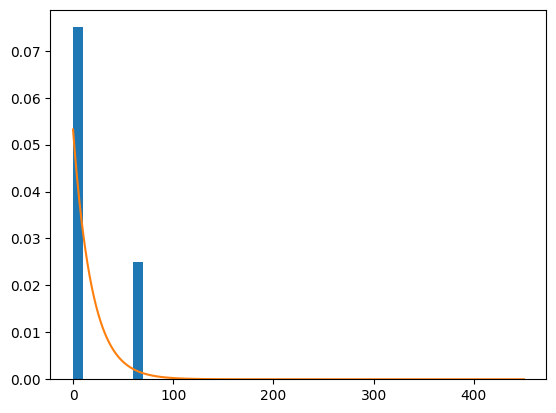

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966]
(0.0, 26.605882352941176)


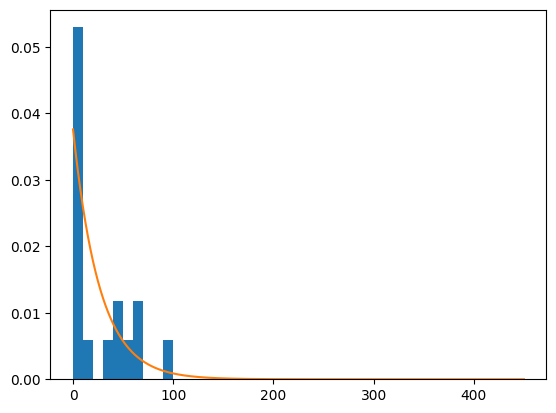

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045]
(0.0, 33.24444444444444)


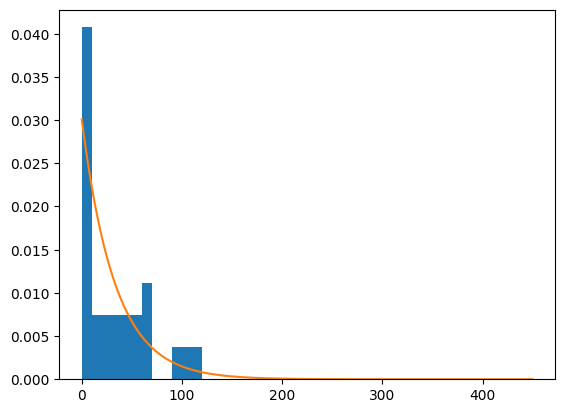

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045, 7.299999999999997, 81.3, 43.599999999999994, 90.20000000000002, 25.600000000000023, 71.10000000000002, 7.0, 26.30000000000001, 56.5, 31.09999999999991, 15.5, 5.199999999999932]
(0.0, 34.82820512820512)


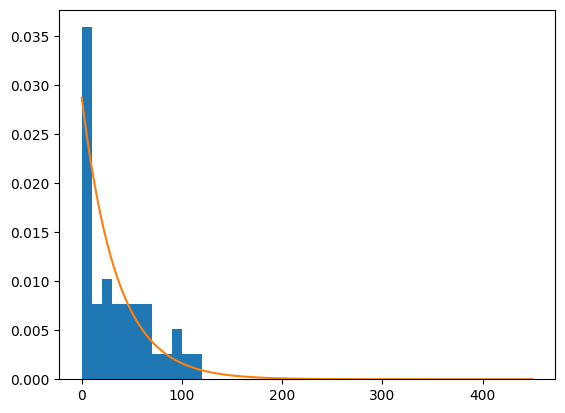

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045, 7.299999999999997, 81.3, 43.599999999999994, 90.20000000000002, 25.600000000000023, 71.10000000000002, 7.0, 26.30000000000001, 56.5, 31.09999999999991, 15.5, 5.199999999999932, 10.199999999999996, 60.9, 45.599999999999994, 7.799999999999983, 3.3999999999999773, 98.80000000000001, 33.400000000000006, 21.19999999999999, 43.10000000000002, 69.0, 59.19999999999999, 24.800000000000068, 34.19999999999993, 42.799999999999955, 66.10000000000002]
(0.0, 36.64444444444444)


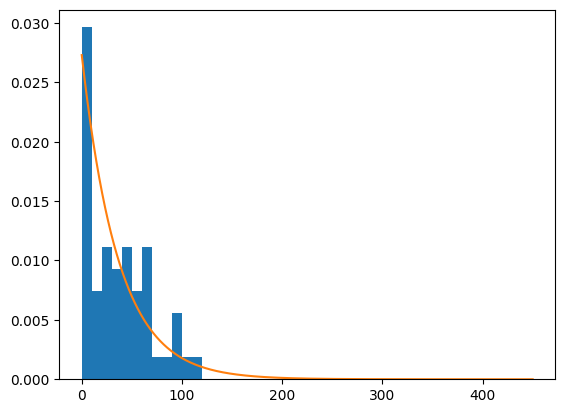

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045, 7.299999999999997, 81.3, 43.599999999999994, 90.20000000000002, 25.600000000000023, 71.10000000000002, 7.0, 26.30000000000001, 56.5, 31.09999999999991, 15.5, 5.199999999999932, 10.199999999999996, 60.9, 45.599999999999994, 7.799999999999983, 3.3999999999999773, 98.80000000000001, 33.400000000000006, 21.19999999999999, 43.10000000000002, 69.0, 59.19999999999999, 24.800000000000068, 34.19999999999993, 42.799999999999955, 66.10000000000002, 23.4, 27.400000000000006, 25.400000000000006, 101.19999999999999, 30.299999999999983, 43.80000000000001, 4.0, 54.5

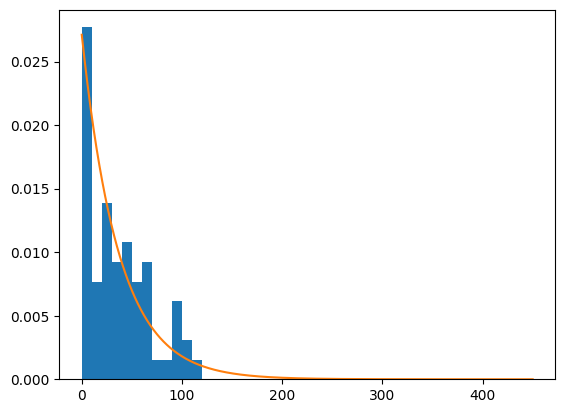

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045, 7.299999999999997, 81.3, 43.599999999999994, 90.20000000000002, 25.600000000000023, 71.10000000000002, 7.0, 26.30000000000001, 56.5, 31.09999999999991, 15.5, 5.199999999999932, 10.199999999999996, 60.9, 45.599999999999994, 7.799999999999983, 3.3999999999999773, 98.80000000000001, 33.400000000000006, 21.19999999999999, 43.10000000000002, 69.0, 59.19999999999999, 24.800000000000068, 34.19999999999993, 42.799999999999955, 66.10000000000002, 23.4, 27.400000000000006, 25.400000000000006, 101.19999999999999, 30.299999999999983, 43.80000000000001, 4.0, 54.5

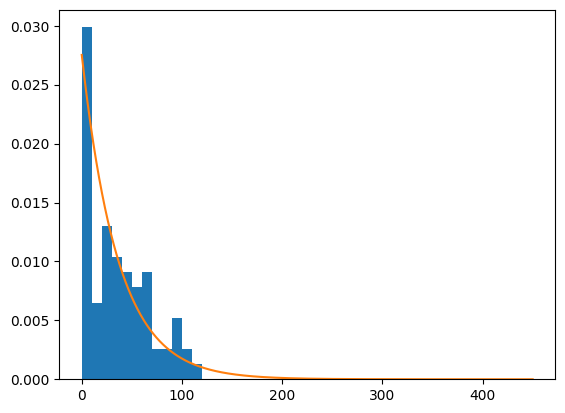

[8.900000000000002, 1.1000000000000014, 1.1000000000000085, 2.299999999999983, 65.60000000000002, 3.200000000000017, 0.8000000000000114, 67.30000000000001, 3.7, 2.5, 3.3999999999999986, 98.8, 54.19999999999999, 40.099999999999994, 39.0, 49.19999999999999, 11.099999999999966, 20.700000000000003, 100.49999999999999, 59.099999999999994, 16.799999999999983, 28.30000000000001, 2.0, 37.39999999999998, 7.0, 112.79999999999995, 60.700000000000045, 7.299999999999997, 81.3, 43.599999999999994, 90.20000000000002, 25.600000000000023, 71.10000000000002, 7.0, 26.30000000000001, 56.5, 31.09999999999991, 15.5, 5.199999999999932, 10.199999999999996, 60.9, 45.599999999999994, 7.799999999999983, 3.3999999999999773, 98.80000000000001, 33.400000000000006, 21.19999999999999, 43.10000000000002, 69.0, 59.19999999999999, 24.800000000000068, 34.19999999999993, 42.799999999999955, 66.10000000000002, 23.4, 27.400000000000006, 25.400000000000006, 101.19999999999999, 30.299999999999983, 43.80000000000001, 4.0, 54.5

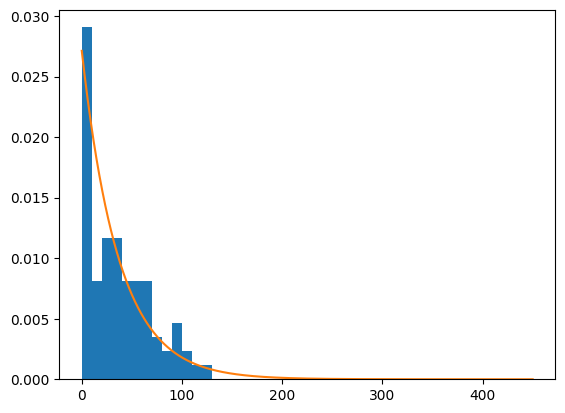

From 12 to 11
[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0]
(0.0, 42.68181818181818)


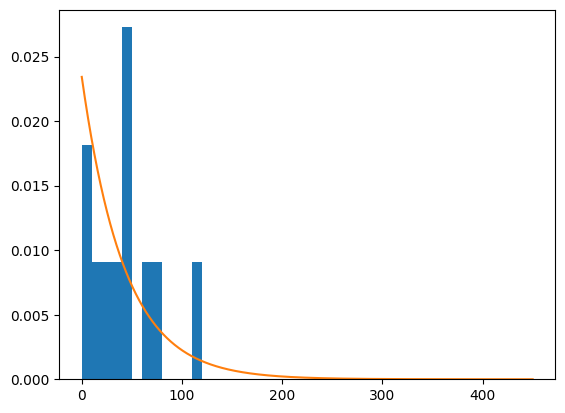

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991]
(0.0, 45.67916666666665)


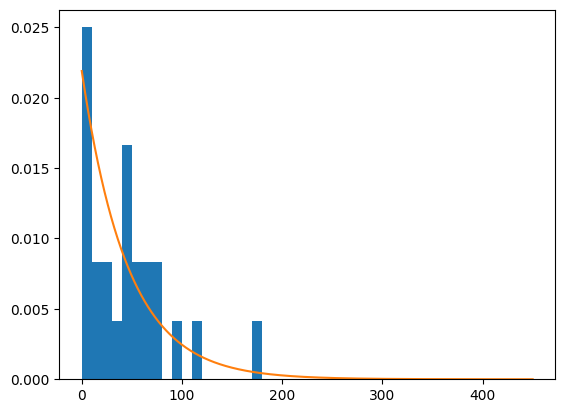

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5]
(0.0, 40.28947368421051)


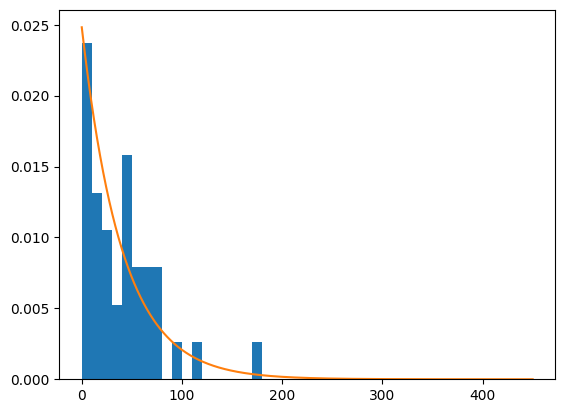

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5, 29.4, 61.0, 3.8999999999999915, 2.3000000000000114, 72.09999999999997, 35.19999999999999, 44.69999999999999, 59.599999999999966, 49.80000000000007, 6.7000000000000455, 20.800000000000068]
(0.0, 39.11224489795919)


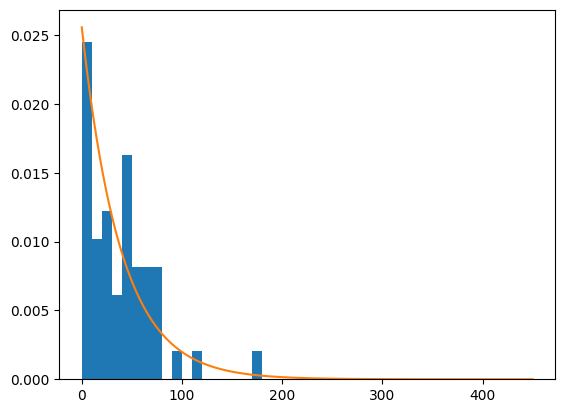

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5, 29.4, 61.0, 3.8999999999999915, 2.3000000000000114, 72.09999999999997, 35.19999999999999, 44.69999999999999, 59.599999999999966, 49.80000000000007, 6.7000000000000455, 20.800000000000068, 1.8000000000000043, 1.0999999999999943, 26.5, 18.099999999999994, 11.5, 44.30000000000001, 8.299999999999955, 1.400000000000034, 25.399999999999977, 29.0, 2.1000000000000227, 8.800000000000068, 13.799999999999955]
(0.0, 34.009677419354844)


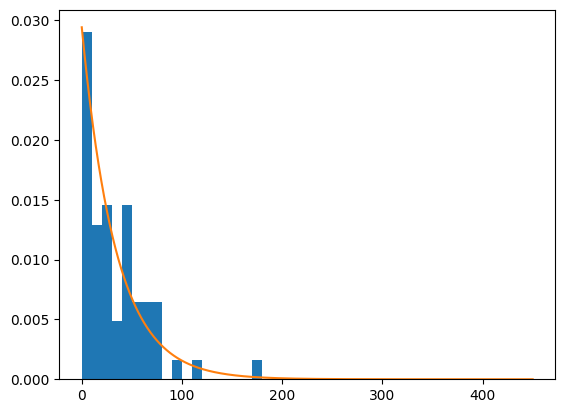

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5, 29.4, 61.0, 3.8999999999999915, 2.3000000000000114, 72.09999999999997, 35.19999999999999, 44.69999999999999, 59.599999999999966, 49.80000000000007, 6.7000000000000455, 20.800000000000068, 1.8000000000000043, 1.0999999999999943, 26.5, 18.099999999999994, 11.5, 44.30000000000001, 8.299999999999955, 1.400000000000034, 25.399999999999977, 29.0, 2.1000000000000227, 8.800000000000068, 13.799999999999955, 56.4, 9.399999999999991, 10.499999999999986, 4.900000000000006, 

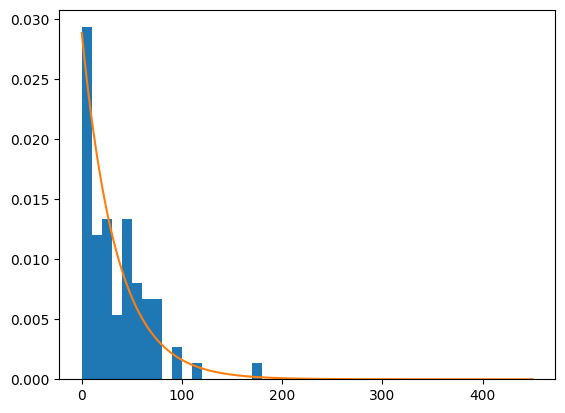

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5, 29.4, 61.0, 3.8999999999999915, 2.3000000000000114, 72.09999999999997, 35.19999999999999, 44.69999999999999, 59.599999999999966, 49.80000000000007, 6.7000000000000455, 20.800000000000068, 1.8000000000000043, 1.0999999999999943, 26.5, 18.099999999999994, 11.5, 44.30000000000001, 8.299999999999955, 1.400000000000034, 25.399999999999977, 29.0, 2.1000000000000227, 8.800000000000068, 13.799999999999955, 56.4, 9.399999999999991, 10.499999999999986, 4.900000000000006, 

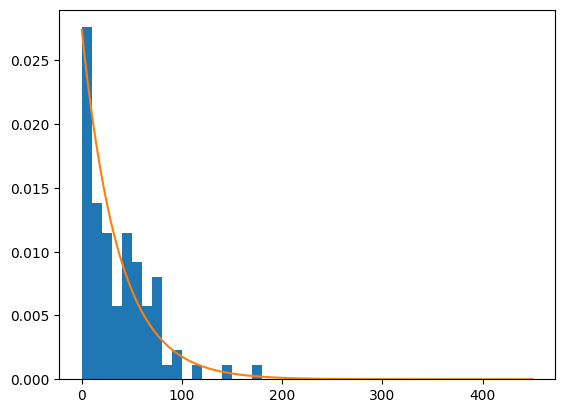

[22.5, 40.39999999999999, 9.099999999999994, 46.2, 43.0, 30.69999999999999, 111.69999999999999, 76.19999999999999, 18.100000000000023, 68.59999999999997, 3.0, 27.800000000000004, 19.9, 54.8, 40.7, 5.599999999999994, 6.300000000000011, 0.19999999999998863, 59.5, 9.099999999999966, 95.80000000000001, 75.5, 170.5, 61.09999999999991, 27.699999999999996, 54.7, 44.60000000000001, 11.5, 49.30000000000001, 4.5, 74.30000000000001, 13.0, 28.399999999999977, 68.10000000000002, 4.399999999999977, 37.60000000000002, 6.100000000000023, 10.5, 29.4, 61.0, 3.8999999999999915, 2.3000000000000114, 72.09999999999997, 35.19999999999999, 44.69999999999999, 59.599999999999966, 49.80000000000007, 6.7000000000000455, 20.800000000000068, 1.8000000000000043, 1.0999999999999943, 26.5, 18.099999999999994, 11.5, 44.30000000000001, 8.299999999999955, 1.400000000000034, 25.399999999999977, 29.0, 2.1000000000000227, 8.800000000000068, 13.799999999999955, 56.4, 9.399999999999991, 10.499999999999986, 4.900000000000006, 

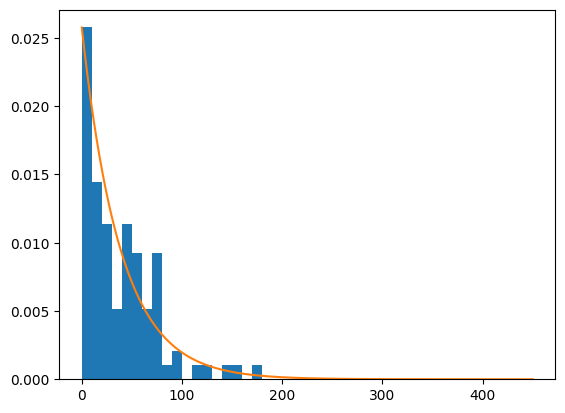

From 12 to 13
[]


ValueError: zero-size array to reduction operation minimum which has no identity

In [ ]:
# inter lane correlation
lane0s=[10,11,11,12,12,13,13, 14,14,15]
lane1s=[11,10,12,11,13,12,14,13,15,14 ]
for l in range(len(lane0s)):

  shift_times=[]
  lane0=lane0s[l]
  lane1=lane1s[l]

  print("From", lane0, "to", lane1)

  for x_low in x_lows:

    shockwave_t0=np.array(shockwave_start_times[lane0][x_low])
    shockwave_t1=np.array(shockwave_start_times[lane1][x_low])

    for t0 in shockwave_t0:
      t1_after=shockwave_t1[shockwave_t1>t0]
      if not len(t1_after)==0:
        shift_times.append(min(t1_after-t0))
    print(shift_times)
    params=ss.expon.fit(shift_times, floc=0)
    print(params)
    next_times=np.linspace(0,450, 10000)
    exp_dens=ss.expon.pdf(next_times, *params)


    plt.hist(shift_times, bins=[i*10 for i in range(0,46)], density=True  )
    plt.plot(next_times, exp_dens)
    plt.show()


# Markov Process

In [ ]:
lc_df.head()

,Unnamed: 0.1,Unnamed: 0,ID,time,location,old_lane,new_lane,MLC
0,0,0,34,337.5,27.015579,-4,-5,1
1,1,1,34,337.8,30.016180,-5,-4,0
2,2,2,34,337.9,31.016254,-4,-5,1
3,3,3,71,844.4,21.014378,-3,-4,1
4,4,4,71,847.6,48.017724,-4,-5,1


In [ ]:

x_low=100
x_high=150
lc_data=lc_df[(lc_df["location"]>x_low) & (lc_df["location"]<x_high)]
#inf_ts_by_lane[-3], inf_xs_by_lane[-3]
t_wd=10
num_eps=10 # if less than this number does not count as shockwaves
wave_ts={}
wave_xs={}
for lane in lanes:
  wave_ts[lane]=inf_ts_by_lane[lane][(inf_xs_by_lane[lane]>x_low) & (inf_xs_by_lane[lane]<x_high) ]
  wave_xs[lane]=inf_xs_by_lane[lane][(inf_xs_by_lane[lane]>x_low) & (inf_xs_by_lane[lane]<x_high) ]

states_by_lane={} # whether shockwave exists at each
most_recent_starts={} # the most recent start time of shockwaves on each lane
current_durations={} # how long the shockwaves on each lane has been going on
lcs_adj={} # the number of lane changes from the adjacent lane [-1, 0, +1]

for lane in lanes:
  #lc_lane=lc_data[]
  states_by_lane[lane]=[]
  most_recent_starts[lane]=[]
  current_durations[lane]=[]
  lcs_adj[lane]=[]
  for t in range(0, 7000, t_wd):
    # the lane changes:
    #-3, -4, -5
    lc_num3=len(lc_data[(lc_data["time"]>t) & (lc_data["time"]<t+t_wd) & (lc_data["old_lane"]==-3) & (lc_data["new_lane"]==lane) ])
    lc_num4=len(lc_data[(lc_data["time"]>t) & (lc_data["time"]<t+t_wd) & (lc_data["old_lane"]==-4) & (lc_data["new_lane"]==lane) ])
    lc_num5=len(lc_data[(lc_data["time"]>t) & (lc_data["time"]<t+t_wd) & (lc_data["old_lane"]==-5) & (lc_data["new_lane"]==lane) ])
    lcs_adj[lane].append([lc_num3, lc_num4, lc_num5])

    rel_x=wave_xs[lane][(wave_ts[lane]>t) & (wave_ts[lane]<t+t_wd)]
    #print(len(rel_x))

    if len(rel_x)>num_eps:
      states_by_lane[lane].append(1)
      if len(current_durations[lane])!=0:
        # should be the same for both of the below if the lane is currently having a shockwave
        current_durations[lane].append(current_durations[lane][-1]+1)
        most_recent_starts[lane].append(current_durations[lane][-1])

      else:

        current_durations[lane].append(1)
        most_recent_starts[lane].append(1)
    else:
      # no shockwave is going on yet
      states_by_lane[lane].append(0)
      current_durations[lane].append(0)

      # past shockwaves
      if max(current_durations[lane])==0:
        most_recent_starts[lane].append(0)
      else:
        most_recent_starts[lane].append(most_recent_starts[lane][-1]+1)

# states_by_lane[lane] returns a list of the existence of the shockwaves, 0 for no and 1 for yes
# find the biggest time across all lanes where the shockwave has occured
ini_step0=0
for lane in lanes:

  ini_step=(np.where(np.array(states_by_lane[lane])>0)[0][0])
  if ini_step>ini_step0:
    ini_step0=ini_step

In [ ]:
lc_data

,Unnamed: 0.1,Unnamed: 0,ID,time,location,old_lane,new_lane,MLC
27,27,27,621,4.5,135.022198,-3,-4,0
58,58,58,754,101.0,108.019934,-4,-5,0
59,59,59,754,101.4,113.020310,-5,-4,0
60,60,60,754,101.8,118.020721,-4,-5,0
61,61,61,758,103.1,102.019547,-4,-5,0
...,...,...,...,...,...,...,...,...
3991,3991,3991,10359,6965.4,114.020392,-4,-5,0
4004,4004,4004,10396,6994.8,136.022281,-4,-5,0
4008,4008,4008,10410,7004.8,136.022281,-4,-5,0
4044,4044,4044,10491,7065.5,111.020145,-5,-4,0


In [ ]:
new_states_by_lane={} # whether shockwave exists at each
new_most_recent_starts={} # the most recent start time of shockwaves on each lane
new_current_durations={} # how long the shockwaves on each lane has been going on
new_lcs_adj={} # the number of lane changes from the adjacent lane [-1, 0, +1]

for lane in lanes:
  new_states_by_lane[lane]=states_by_lane[lane][ini_step:] # whether shockwave exists at each
  new_most_recent_starts[lane]=most_recent_starts[lane][ini_step:] # the most recent start time of shockwaves on each lane
  new_current_durations[lane]= current_durations[lane][ini_step:]# how long the shockwaves on each lane has been going on
  new_lcs_adj[lane]=lcs_adj[lane][ini_step:] # the number of lane changes from the adjacent lane [-1, 0, +1]

In [ ]:
states_mat=[]
for lane in lanes:
  states_mat.append(states_by_lane[lane][ini_step:])
states_mat=np.transpose(states_mat)

# all the possible states
all_states=np.array([[0,0,0], [0,0,1], [0,1,0], [0,1,1], [1,0,0], [1,0,1], [1,1,0], [1,1,1]])
#for i in range(len(states_mat)):
  #if np.any(np.all(all_states == states_mat[i], axis=1))==False:
  #if not states_mat[i] in states:
    #all_states=np.concatenate((all_states, [states_mat[i]]))


In [ ]:
transition=np.zeros((len(all_states), len(all_states)))
for i in range(len(states_mat)-1):
  state0=states_mat[i]
  state1=states_mat[i+1]
  transition[state0[0]*4+state0[1]*2+state0[2]*1][state1[0]*4+state1[1]*2+state1[2]*1]=transition[state0[0]*4+state0[1]*2+state0[2]*1][state1[0]*4+state1[1]*2+state1[2]*1]+1


In [ ]:
for i in range(len(all_states)):
  for j in range(len(all_states)):
    print(all_states[i], all_states[j],transition[i][j], transition[i][j]/sum(transition[i]) )
  print()


[0 0 0] [0 0 0] 130.0 0.7303370786516854
[0 0 0] [0 0 1] 12.0 0.06741573033707865
[0 0 0] [0 1 0] 13.0 0.07303370786516854
[0 0 0] [0 1 1] 5.0 0.028089887640449437
[0 0 0] [1 0 0] 9.0 0.05056179775280899
[0 0 0] [1 0 1] 2.0 0.011235955056179775
[0 0 0] [1 1 0] 4.0 0.02247191011235955
[0 0 0] [1 1 1] 3.0 0.016853932584269662

[0 0 1] [0 0 0] 16.0 0.2711864406779661
[0 0 1] [0 0 1] 16.0 0.2711864406779661
[0 0 1] [0 1 0] 4.0 0.06779661016949153
[0 0 1] [0 1 1] 8.0 0.13559322033898305
[0 0 1] [1 0 0] 2.0 0.03389830508474576
[0 0 1] [1 0 1] 7.0 0.11864406779661017
[0 0 1] [1 1 0] 0.0 0.0
[0 0 1] [1 1 1] 6.0 0.1016949152542373

[0 1 0] [0 0 0] 10.0 0.22727272727272727
[0 1 0] [0 0 1] 4.0 0.09090909090909091
[0 1 0] [0 1 0] 10.0 0.22727272727272727
[0 1 0] [0 1 1] 6.0 0.13636363636363635
[0 1 0] [1 0 0] 2.0 0.045454545454545456
[0 1 0] [1 0 1] 0.0 0.0
[0 1 0] [1 1 0] 6.0 0.13636363636363635
[0 1 0] [1 1 1] 6.0 0.13636363636363635

[0 1 1] [0 0 0] 2.0 0.024096385542168676
[0 1 1] [0 0 1] 9.0 

In [ ]:
#new_states_by_lane={} # whether shockwave exists at each
#new_most_recent_starts={} # the most recent start time of shockwaves on each lane
#new_current_durations={} # how long the shockwaves on each lane has been going on
#new_lcs_adj={} # the number of lane changes from the adjacent lane [-1, 0, +1]



{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16}

In [ ]:
#check a particular state on a certain dimension
lane0=-5
durations=list(set(new_current_durations[lane0]))
init_state=1

for duration in durations:
  if duration==0:
    continue
  print(duration)
  to1=0
  to0=0
  for i in range(len(new_states_by_lane[lane0])-1):
    if new_states_by_lane[lane0][i]==0:
      continue
    if new_current_durations[lane0][i]!=duration:
      continue

    if new_states_by_lane[lane0][i+1]==1:
      to1=to1+1
    else:
      to0=to0+1
  print(to0, to1, to1/(to0+to1))
  print()








1
17 60 0.7792207792207793

2
11 49 0.8166666666666667

3
5 44 0.8979591836734694

4
5 39 0.8863636363636364

5
10 29 0.7435897435897436

6
11 18 0.6206896551724138

7
4 14 0.7777777777777778

8
3 11 0.7857142857142857

9
1 10 0.9090909090909091

10
4 6 0.6

11
2 4 0.6666666666666666

12
1 3 0.75

13
2 1 0.3333333333333333

14
0 1 1.0

15
0 1 1.0

16
1 0 0.0



In [ ]:
transition

array([[130.,  12.,  13.,   5.,   9.,   2.,   4.,   3.],
       [ 16.,  16.,   4.,   8.,   2.,   7.,   0.,   6.],
       [ 10.,   4.,  10.,   6.,   2.,   0.,   6.,   6.],
       [  2.,   9.,   7.,  31.,   1.,   5.,   4.,  24.],
       [ 11.,   1.,   2.,   2.,  15.,   3.,   8.,   8.],
       [  4.,   6.,   1.,   1.,   9.,   6.,   4.,  12.],
       [  2.,   2.,   5.,   3.,   8.,   4.,  19.,  15.],
       [  4.,   9.,   2.,  27.,   4.,  16.,  13., 107.]])

In [ ]:
# examing the

array([[0, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 1],
       [1, 0, 0],
       [1, 0, 1],
       [1, 1, 0],
       [1, 1, 1]])

In [ ]:
np.where(all_states==)

(array([0, 0, 0, 2, 3, 3, 4, 4, 5, 6, 7, 7]),
 array([0, 1, 2, 0, 0, 1, 0, 2, 2, 1, 1, 2]))

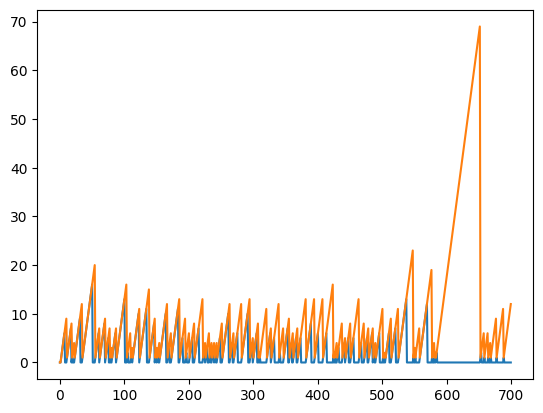

In [ ]:
#for i in range(len(most_recent_starts[lane])):
  #print(current_durations[lane][i],most_recent_starts[lane][i])
ts=[t for t in range(len(most_recent_starts[lane]))]
plt.plot(ts, current_durations[lane] )
plt.plot(ts, most_recent_starts[lane] )

array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1],
       ...,
       [0, 0, 0],
       [0, 0, 0],
       [0, 0, 0]])

350

In [ ]:
# how long ago the most recent shockwave started
# how long the current shockwave has been there for
# how many lane changes has there been since the most recent shockwave started

304

In [ ]:

# two external variables are density and lane changes
# density and

483

#Taking LC into Consideration

In [ ]:
max_t=800

In [ ]:
lanes

[10, 11, 12, 13, 14, 15]

In [ ]:
start_times=[[], [], [], [], [], []] # 10, 11, 12,13,14,15 are the order
last_times=[[], [], [], [], [], []] # start_time[lane_idx][wave][lane_id] would return the last time step shockwave occured at the the lane
locations=[[], [], [], [], [], []]
#num_lcs=[[], [], [], [], [], []]
for x_low in x_lows:
  lc_rel=lc_df[(lc_df["location"]>=x_low) & (lc_df["location"]<x_low+50)]
  for lane in lanes:
    lc_in=lc_rel[lc_rel["new_lane"]==lane]

    lane_idx=lane-10
    #start_times[lane_idx].append(shockwave_start_times[lane])
    for st in shockwave_start_times[lane][x_low]: # iterate over all the start time
      #rel_3=np.array(shockwave_start_times[-3][x_low])[np.array(shockwave_start_times[-3][x_low])<st]
      #rel_4=np.array(shockwave_start_times[-4][x_low])[np.array(shockwave_start_times[-4][x_low])<st]
      #rel_5=np.array(shockwave_start_times[-5][x_low])[np.array(shockwave_start_times[-5][x_low])<st]
      rel_self=np.array(shockwave_start_times[lane][x_low])[np.array(shockwave_start_times[lane][x_low])<st]
      if lane==10: # only self and right

        rel_right=np.array(shockwave_start_times[lane+1][x_low])[np.array(shockwave_start_times[lane+1][x_low])<st]
        if len(rel_self)!=0 and len(rel_right)!=0:
          lts=[0, max(rel_self), max(rel_right)]# by lane
          start_times[lane_idx].append(st)
          last_times[lane_idx].append(lts)
          locations[lane_idx].append(x_low)
          #num_lcs[lane_idx].append([




      elif lane==15: # only self and left
        rel_left=np.array(shockwave_start_times[lane-1][x_low])[np.array(shockwave_start_times[lane-1][x_low])<st]
        if len(rel_self)!=0 and len(rel_left)!=0:
          lts=[max(rel_left), max(rel_self), 0]# by lane
          start_times[lane_idx].append(st)
          last_times[lane_idx].append(lts)
          locations[lane_idx].append(x_low)

      else:
        rel_right=np.array(shockwave_start_times[lane+1][x_low])[np.array(shockwave_start_times[lane+1][x_low])<st]
        rel_left=np.array(shockwave_start_times[lane-1][x_low])[np.array(shockwave_start_times[lane-1][x_low])<st]
        if len(rel_self)!=0 and len(rel_left)!=0 and len(rel_right)!=0:
          lts=[max(rel_left), max(rel_self), max(rel_right)]# by lane
          start_times[lane_idx].append(st)
          last_times[lane_idx].append(lts)
          locations[lane_idx].append(x_low)







'''
      if len(rel_3)!=0 and len(rel_4)!=0 and len(rel_5)!=0 and st<=max_t:
        lts=[max(rel_3), max(rel_4), max(rel_5)]# by lane
        # now number of lane changes:
        lc3=lc_in[lc_in["old_lane"]==-3]
        lc3=lc3[(lc3["time"]>=max(rel_3)) & (lc3["time"]<=st) ]

        lc4=lc_in[lc_in["old_lane"]==-4]
        lc4=lc4[(lc4["time"]>=max(rel_4)) & (lc4["time"]<=st) ]

        lc5=lc_in[lc_in["old_lane"]==-5]
        lc5=lc5[(lc5["time"]>=max(rel_5)) & (lc5["time"]<=st) ]

        lc_nums=[len(lc3)/(st-max(rel_3)), len(lc4)/(st-max(rel_4)), len(lc5)/(st-max(rel_5))]
        #lc_nums=[len(lc3), len(lc4), len(lc5)]
        #print(x_low, lane, (last_times[lane_idx]))

        last_times[lane_idx].append(lts)
        locations[lane_idx].append(x_low)
        start_times[lane_idx].append(st)
        num_lcs[lane_idx].append(lc_nums)

'''

for i in range(len(start_times)):
  start_times[i]=np.transpose(start_times[i])
for i in range(len(last_times)):
  last_times[i]=np.transpose(last_times[i])

for i in range(len(locations)):
  locations[i]=np.array(locations[i])


In [ ]:
durs00_rel

NameError: name 'durs00_rel' is not defined

10 10


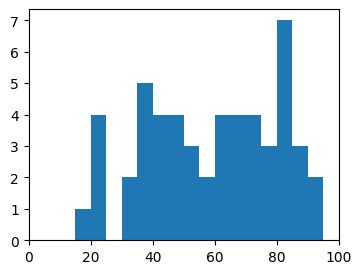

11 10


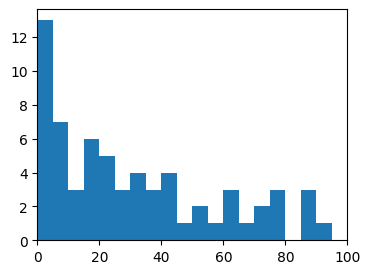

10 11


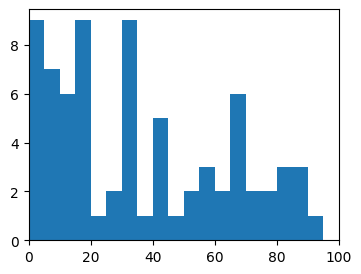

11 11


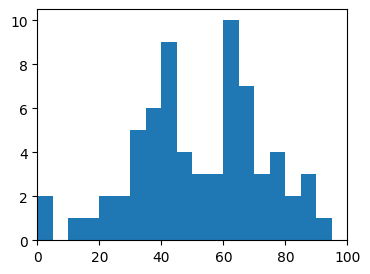

12 11


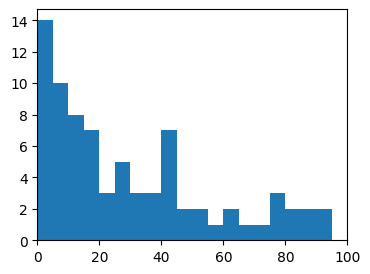

11 12


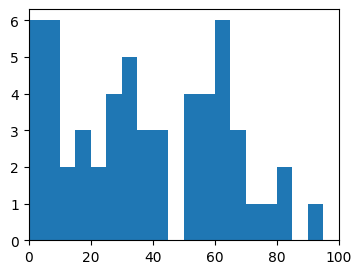

12 12


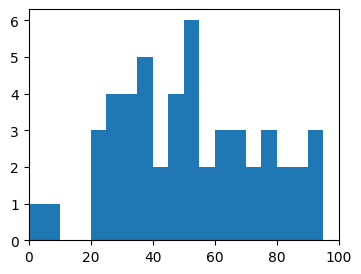

13 12


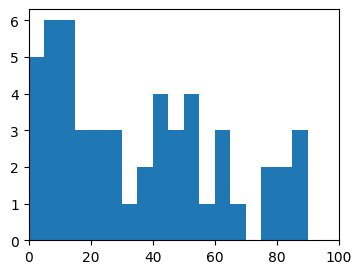

12 13


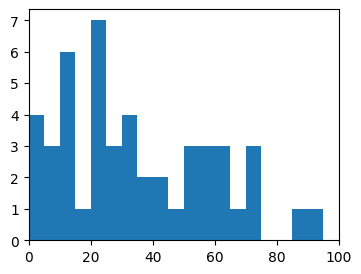

13 13


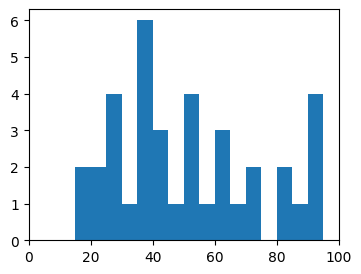

14 13


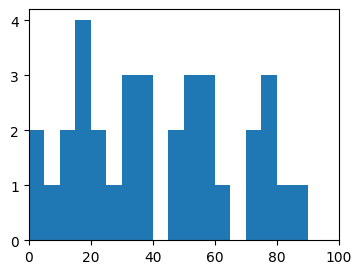

13 14


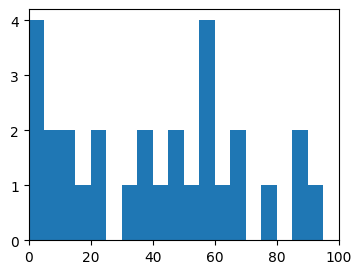

14 14


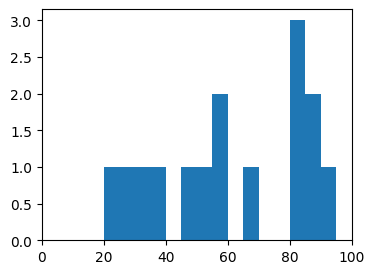

15 14


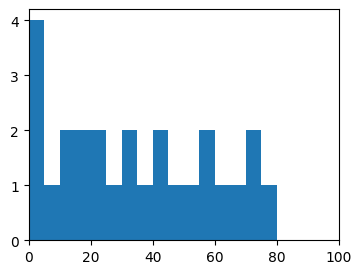

14 15


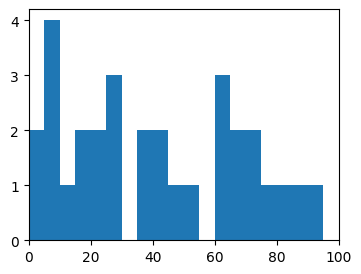

15 15


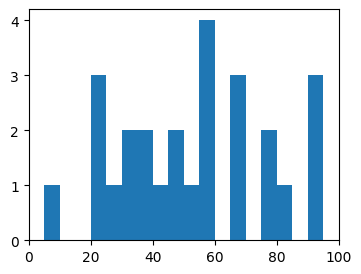

In [ ]:
# test the distributions
target_lanes=[10,11,12,13,14,15]
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    print(source_lane, target_lane)
    plt.figure(figsize=(4,3))
    dur_vals=start_times[target_lane-10]-last_times[target_lane-10][source_lane-target_lane+1]
    plt.hist(dur_vals, bins=[i*5 for i in range(0,20)])
    plt.xlim(0,100)
    plt.show()

    globals()["durs"+str(source_lane-10)+str(target_lane-10)+"_rel"]=dur_vals

In [ ]:
def get_tscore(optimized_values, perturb):
    # Note: Cannot keep assigning the value to the loss function in the loop under parallel computing setting
    param_perturbations_ij = []
    param_perturbations_i = []
    epsilons =  perturb*np.ones(len(optimized_values))
    hessian = np.zeros((len(optimized_values), len(optimized_values)))
    fs = []
    fs.append(wei_dist_loss(optimized_values))

    for i_idx in range(len(optimized_values)):
        param_perturbations_ij.append([])
        params_i = optimized_values.copy()
        params_i[i_idx] += epsilons[i_idx]
        param_perturbations_i.append(params_i)
        for j_idx in range(len(optimized_values)):
            params_ij = optimized_values.copy()
            params_ij[i_idx] += epsilons[i_idx]
            params_ij[j_idx] += epsilons[j_idx]
            param_perturbations_ij[-1].append(params_ij)

    f_is = np.zeros(len(optimized_values))
    f_ijs = np.zeros((len(optimized_values), len(optimized_values)))

    for i_idx in range(len(optimized_values)):
        #if i_idx==11:
          #print("perturb_11", param_perturbations_i[i_idx], wei_dist_loss(param_perturbations_i[i_idx]) )
          #print("regular", optimized_values, wei_dist_loss(optimized_values)  )
        f_is[i_idx] = wei_dist_loss(param_perturbations_i[i_idx])
        for j_idx in range(len(optimized_values)):
            if f_ijs[j_idx][i_idx] != 0:
                f_ijs[i_idx][j_idx] = f_ijs[j_idx][i_idx]
            else:
                f_ijs[i_idx][j_idx] = wei_dist_loss(param_perturbations_ij[i_idx][j_idx])

    for i_idx in range(len(optimized_values)):
        for j_idx in range(len(optimized_values)):
            #if i_idx==11 and j_idx==11:
                #print(f_ijs[i_idx][j_idx], f_is[i_idx], f_is[j_idx], fs[0])
            hessian[i_idx][j_idx] = (f_ijs[i_idx][j_idx] - f_is[i_idx] - f_is[j_idx] + fs[0]) / (epsilons[i_idx] * epsilons[j_idx])

    # Regularize the Hessian if it's not positive definite
    #print(hessian)
    if not is_positive_definite(hessian):
        epsilon = 1e-5  # Small regularization term
        hessian += epsilon * np.eye(hessian.shape[0])

    # Invert the Hessian to get the covariance matrix
    try:
        cov_matrix = inv(hessian)
    except np.linalg.LinAlgError:
        cov_matrix = pinv(hessian)  # Use pseudo-inverse if the Hessian is singular

    #print("Covariance matrix diagonal:", np.diag(cov_matrix))

    # Standard errors
    standard_errors = np.sqrt(np.diag(cov_matrix))

    # Handle possible negative variances (standard errors)


    tscores = optimized_values / standard_errors
    return tscores

def is_positive_definite(matrix):
    """ Check if a matrix is positive definite """
    eigenvalues = eigh(matrix, eigvals_only=True)
    return np.all(eigenvalues > 0)

def wei_dist(lamda, k, x_diff): # not normalized
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))

def wei_cdf(lamda, k, x_diff_max):
  return 1- (np.exp(-(x_diff_max/lamda)**k))




In [ ]:
def wei_dist_loss(coefs):
  lam00, lam10, lam01, lam11, lam21, lam12,lam22, lam32, lam23, lam33, lam43, lam34, lam44, lam54, lam45, lam55= coefs[0:16]
  k00, k10, k01, k11, k21, k12, k22, k32, k23, k33, k43, k34, k44, k54, k45, k55=coefs[16:32]
  p00, p10, p01, p11, p21, p12, p22, p32, p23, p33, p43, p34, p44, p54, p45, p55=coefs[32:]

  prob0=p00*wei_dist(lam00, k00, durs00_rel)+ p10*wei_dist(lam10, k10, durs10_rel)
  prob1=p01*wei_dist(lam01, k01, durs01_rel)+ p11*wei_dist(lam11, k11, durs11_rel)+ p21*wei_dist(lam21, k21, durs21_rel)
  prob2=p12*wei_dist(lam12, k12, durs12_rel)+ p22*wei_dist(lam22, k22, durs22_rel)+ p32*wei_dist(lam32, k32, durs32_rel)
  prob3=p23*wei_dist(lam23, k23, durs23_rel)+ p33*wei_dist(lam33, k33, durs33_rel)+ p43*wei_dist(lam43, k43, durs43_rel)
  prob4=p34*wei_dist(lam34, k34, durs34_rel)+ p44*wei_dist(lam44, k44, durs44_rel)+ p54*wei_dist(lam54, k54, durs54_rel)
  prob5=p45*wei_dist(lam45, k45, durs45_rel)+ p55*wei_dist(lam55, k55, durs55_rel)

  ll0=np.log(prob0+0.0000000001)
  ll1=np.log(prob1+0.0000000001)
  ll2=np.log(prob2+0.0000000001)
  ll3=np.log(prob3+0.0000000001)
  ll4=np.log(prob4+0.0000000001)
  ll5=np.log(prob5+0.0000000001)

  return -(sum(ll0)+sum(ll1)+sum(ll2)+sum(ll3)+sum(ll4)+sum(ll5))


In [ ]:
lam_ini_raw=np.concatenate((100*np.ones(16), 1*np.ones(16), [0.5, 0.5, 0.333, 0.333, 0.334, 0.333, 0.333, 0.334, 0.333, 0.333, 0.334, 0.333, 0.333, 0.334, 0.5, 0.5] ))
initial_guess=lam_ini_raw
raw_bounds =  []
for i in range(0,16):
  raw_bounds.append((0,400))
for i in range(0,16):
  raw_bounds.append((0,5))
for i in range(0,16):
  raw_bounds.append((0,1))

cons=({'type': 'eq', 'fun': lambda x:  1- x[32] - x[33]},
 {'type': 'eq', 'fun': lambda x:  1- x[34] - x[35]-x[36]},
  {'type': 'eq', 'fun': lambda x:  1- x[37] - x[38]- x[39]},
  {'type': 'eq', 'fun': lambda x:  1- x[40] - x[41]- x[42]},
      {'type': 'eq', 'fun': lambda x:  1- x[43] - x[44]- x[45]},
      {'type': 'eq', 'fun': lambda x:  1- x[46] - x[47]})

In [ ]:
result = minimize(wei_dist_loss, initial_guess, bounds=raw_bounds, constraints=cons, options={ 'disp': True, "maxiter":5000, })

<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: divide by zero encountered in scalar divide
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))
<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: divide by zero encountered in divide
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))
<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: invalid value encountered in multiply
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))


Optimization terminated successfully    (Exit mode 0)
            Current function value: 1614.5561507845289
            Iterations: 157
            Function evaluations: 7733
            Gradient evaluations: 157


In [ ]:
optimized_values = result.x
print(optimized_values)
tscores=get_tscore(optimized_values, 0.00001)
print(tscores)

[8.04437999e+01 2.93813154e+01 1.49007573e+01 6.09386287e+01
 2.34972174e+01 3.73359211e+01 5.95630936e+00 2.58005560e+01
 3.85387158e+01 7.63188374e+01 9.51674422e+01 3.97645458e+01
 1.03184620e+02 2.81259516e+01 4.43058943e+01 1.10128191e+02
 3.31708857e+00 8.81711653e-01 8.42194383e-01 4.59746994e+00
 9.24900389e-01 1.09217220e+00 2.47892576e+00 1.15735118e+00
 1.39580505e+00 5.00000000e+00 3.08821897e+00 9.97840451e-01
 5.00000000e+00 1.06917198e+00 1.21826561e+00 1.63928385e+00
 2.59825807e-01 7.40174193e-01 2.25993576e-01 1.69788761e-01
 6.04217663e-01 5.99855530e-01 0.00000000e+00 4.00144470e-01
 9.55978876e-01 4.40211241e-02 0.00000000e+00 5.84549241e-01
 2.51614665e-02 3.90289293e-01 4.11399268e-01 5.88600732e-01]
[8.82261535 5.07814595 1.16064203 8.6041622  3.72321155 5.29723662
 0.03500283 3.94578722 8.24112559 2.7135024  0.30277798 4.71576046
        nan 5.04596646 3.08970554 6.85215152 3.96589497 8.86451262
 3.5516001  2.80759391 8.17572588 6.21702115 0.0093019  5.20150734

<ipython-input-26-2a9df8e707b1>:56: RuntimeWarning: invalid value encountered in sqrt
  standard_errors = np.sqrt(np.diag(cov_matrix))


In [ ]:
fmt = "{:<12} {:<18} {}"

var_names=[]
pair_names=[]
drop_pairs=[(13,13), (13,14), (14,14), (12,12)]
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    pair_names.append((target_lane, source_lane))
    var_names.append("lambda_"+str(target_lane)+","+ str(source_lane))
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    pair_names.append((target_lane, source_lane))
    var_names.append("k_"+str(target_lane)+","+ str(source_lane))
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    pair_names.append((target_lane, source_lane))
    var_names.append("p_"+str(target_lane)+","+ str(source_lane))

print(fmt.format("Parameter", "Value", "t-score"))
print(fmt.format("--------", "-----------------", "-------"))

for v in range(len(var_names)):
    if pair_names[v] in drop_pairs:
      continue

    print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{round(tscores[v],3)}"))
    #print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{1}"))

Parameter    Value              t-score
--------     -----------------  -------
lambda_10,10 80.444             8.823
lambda_10,11 29.381             5.078
lambda_11,10 14.901             1.161
lambda_11,11 60.939             8.604
lambda_11,12 23.497             3.723
lambda_12,11 37.336             5.297
lambda_12,13 25.801             3.946
lambda_13,12 38.539             8.241
lambda_14,13 39.765             4.716
lambda_14,15 28.126             5.046
lambda_15,14 44.306             3.09
lambda_15,15 110.128            6.852
k_10,10      3.317              3.966
k_10,11      0.882              8.865
k_11,10      0.842              3.552
k_11,11      4.597              2.808
k_11,12      0.925              8.176
k_12,11      1.092              6.217
k_12,13      1.157              5.202
k_13,12      1.396              8.009
k_14,13      0.998              nan
k_14,15      1.069              4.757
k_15,14      1.218              4.315
k_15,15      1.639              6.277
p_10,10    

In [ ]:
# after dropping:

def wei_dist_loss(coefs):
  lam00, lam10, lam01, lam11, lam21, lam12,lam32, lam23, lam34, lam54, lam45, lam55= coefs[0:12]
  k00, k10, k01, k11, k21, k12, k32, k23, k34, k54, k45, k55=coefs[12:24]
  p00, p10, p01, p11, p21, p12, p32, p34, p54, p45, p55=coefs[24:]

  prob0=p00*wei_dist(lam00, k00, durs00_rel)+ p10*wei_dist(lam10, k10, durs10_rel)
  prob1=p01*wei_dist(lam01, k01, durs01_rel)+ p11*wei_dist(lam11, k11, durs11_rel)+ p21*wei_dist(lam21, k21, durs21_rel)
  prob2=p12*wei_dist(lam12, k12, durs12_rel)+ p32*wei_dist(lam32, k32, durs32_rel)
  prob3=wei_dist(lam23, k23, durs23_rel)
  prob4=p34*wei_dist(lam34, k34, durs34_rel)+ p54*wei_dist(lam54, k54, durs54_rel)
  prob5=p45*wei_dist(lam45, k45, durs45_rel)+ p55*wei_dist(lam55, k55, durs55_rel)

  ll0=np.log(prob0+0.0000000001)
  ll1=np.log(prob1+0.0000000001)
  ll2=np.log(prob2+0.0000000001)
  ll3=np.log(prob3+0.0000000001)
  ll4=np.log(prob4+0.0000000001)
  ll5=np.log(prob5+0.0000000001)

  return -(sum(ll0)+sum(ll1)+sum(ll2)+sum(ll3)+sum(ll4)+sum(ll5))

In [ ]:
lam_ini_raw=np.concatenate((100*np.ones(12), 1*np.ones(12), [0.5, 0.5, 0.333, 0.333, 0.334, 0.5, 0.5,  0.5, 0.5, 0.5, 0.5] ))
initial_guess=lam_ini_raw
raw_bounds =  []
for i in range(0,12):
  raw_bounds.append((0,400))
for i in range(0,12):
  raw_bounds.append((0,10))
for i in range(0,11):
  raw_bounds.append((0,1))

cons=({'type': 'eq', 'fun': lambda x:  1- x[24] - x[25]},
 {'type': 'eq', 'fun': lambda x:  1- x[26] - x[27]-x[28]},
  {'type': 'eq', 'fun': lambda x:  1- x[29] - x[30]},

      {'type': 'eq', 'fun': lambda x:  1- x[31] - x[32]},
      {'type': 'eq', 'fun': lambda x:  1- x[33] - x[34]})

In [ ]:
result = minimize(wei_dist_loss, initial_guess, bounds=raw_bounds, constraints=cons, options={ 'disp': True, "maxiter":5000, })

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1615.904800941043
            Iterations: 126
            Function evaluations: 4565
            Gradient evaluations: 126


In [ ]:
optimized_values = result.x
print(optimized_values)
tscores=get_tscore(optimized_values, 0.0001)
print(tscores)

[4.35828121e+01 3.57055763e+01 1.49101784e+01 6.09426086e+01
 2.34938106e+01 3.73358884e+01 2.58008640e+01 4.00924013e+01
 4.06076732e+01 2.83705496e+01 4.43161387e+01 1.10047806e+02
 1.00000000e+01 9.24690033e-01 8.42063295e-01 4.59776134e+00
 9.24910524e-01 1.09214372e+00 1.15734383e+00 1.35573867e+00
 1.01611675e+00 1.07432440e+00 1.21822783e+00 1.63880810e+00
 6.64785103e-02 9.33521490e-01 2.26081550e-01 1.69779953e-01
 6.04138497e-01 5.99842486e-01 4.00157514e-01 6.08369257e-01
 3.91630743e-01 4.11394296e-01 5.88605704e-01]
[13.30452995  6.97195486  1.07400249  8.83559253  3.69411064  5.32455515
  3.80953707  9.02920131  3.47693711  2.30941794  3.47787263  7.2244029
  1.70985219 10.06941856  3.57374739  2.80632223  8.19665311  6.18614336
  5.17600278  8.680098    4.4072834   3.5696369   4.40052904  6.30863899
  1.4876961   7.78412829  1.65982348  1.88416729  4.28656564  4.46791709
  3.28881923  2.90444559  2.02767577  2.82383283  3.72887997]


In [ ]:
len(var_names)

35

In [ ]:
fmt = "{:<12} {:<18} {}"
var_names=[]
drop_pairs=[(13,13), (13,14), (14,14), (12,12)]
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    if (target_lane, source_lane) in drop_pairs:
      continue

    var_names.append("lambda_"+str(target_lane)+","+ str(source_lane))
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    if (target_lane, source_lane) in drop_pairs:
      continue

    pair_names.append((target_lane, source_lane))
    var_names.append("k_"+str(target_lane)+","+ str(source_lane))
for target_lane in target_lanes:
  for source_lane in range(max(target_lane-1, 10), min(target_lane+2, 16)):
    if (target_lane, source_lane) in drop_pairs:
      continue

    if target_lane==13:
      continue

    pair_names.append((target_lane, source_lane))
    var_names.append("p_"+str(target_lane)+","+ str(source_lane))

print(fmt.format("Parameter", "Value", "t-score"))
print(fmt.format("--------", "-----------------", "-------"))

for v in range(len(var_names)):


    print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{round(tscores[v],3)}"))
    #print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{1}"))

Parameter    Value              t-score
--------     -----------------  -------
lambda_10,10 43.583             13.305
lambda_10,11 35.706             6.972
lambda_11,10 14.91              1.074
lambda_11,11 60.943             8.836
lambda_11,12 23.494             3.694
lambda_12,11 37.336             5.325
lambda_12,13 25.801             3.81
lambda_13,12 40.092             9.029
lambda_14,13 40.608             3.477
lambda_14,15 28.371             2.309
lambda_15,14 44.316             3.478
lambda_15,15 110.048            7.224
k_10,10      10.0               1.71
k_10,11      0.925              10.069
k_11,10      0.842              3.574
k_11,11      4.598              2.806
k_11,12      0.925              8.197
k_12,11      1.092              6.186
k_12,13      1.157              5.176
k_13,12      1.356              8.68
k_14,13      1.016              4.407
k_14,15      1.074              3.57
k_15,14      1.218              4.401
k_15,15      1.639              6.309
p_10,10   

In [ ]:
# further dropping:
def wei_dist_loss(coefs):
  lam10, lam21, lam12,lam32, lam23, lam34, lam45, lam55= coefs[0:8]
  k10, k21, k12, k32, k23, k34, k45, k55=coefs[8:16]
  p12, p32, p45, p55=coefs[16:]

  prob0=wei_dist(lam10, k10, durs10_rel)
  prob1=wei_dist(lam21, k21, durs21_rel)
  prob2=p12*wei_dist(lam12, k12, durs12_rel)+ p32*wei_dist(lam32, k32, durs32_rel)
  prob3=wei_dist(lam23, k23, durs23_rel)
  prob4=wei_dist(lam34, k34, durs34_rel)
  prob5=p45*wei_dist(lam45, k45, durs45_rel)+ p55*wei_dist(lam55, k55, durs55_rel)

  ll0=np.log(prob0+0.0000000001)
  ll1=np.log(prob1+0.0000000001)
  ll2=np.log(prob2+0.0000000001)
  ll3=np.log(prob3+0.0000000001)
  ll4=np.log(prob4+0.0000000001)
  ll5=np.log(prob5+0.0000000001)

  return -(sum(ll0)+sum(ll1)+sum(ll2)+sum(ll3)+sum(ll4)+sum(ll5))

In [ ]:
lam_ini_raw=np.concatenate((100*np.ones(8), 1*np.ones(8), [0.5, 0.5,  0.5, 0.5] ))
initial_guess=lam_ini_raw
raw_bounds =  []
for i in range(0,8):
  raw_bounds.append((0,400))
for i in range(0,8):
  raw_bounds.append((0,5))
for i in range(0,4):
  raw_bounds.append((0,1))

cons=({'type': 'eq', 'fun': lambda x:  1- x[16] - x[17]},
 {'type': 'eq', 'fun': lambda x:  1- x[18] - x[19]},


)

In [ ]:
result = minimize(wei_dist_loss, initial_guess, bounds=raw_bounds, constraints=cons, options={ 'disp': True, "maxiter":5000, })

<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: divide by zero encountered in scalar divide
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))
<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: divide by zero encountered in divide
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))
<ipython-input-26-2a9df8e707b1>:70: RuntimeWarning: invalid value encountered in multiply
  return (k/lamda)*((x_diff/lamda)**(k-1))*( np.exp(-(x_diff/lamda)**k))


Optimization terminated successfully    (Exit mode 0)
            Current function value: 1640.397617937042
            Iterations: 85
            Function evaluations: 1818
            Gradient evaluations: 85


In [ ]:
optimized_values = result.x
print(optimized_values)
tscores=get_tscore(optimized_values, 0.0001)
print(tscores)

[ 38.03481415  35.7058441   37.33760278  25.79830469  40.09252116
  51.01832837  44.3365971  109.96484227   0.92887911   0.93759604
   1.09218004   1.15731797   1.35573569   1.2038193    1.21834574
   1.63826403   0.59987338   0.40012662   0.41141611   0.58858389]
[ 7.38159761  8.1563684   5.33148263  3.80373745  9.02927861  6.64024133
  3.48131591  7.23360985 10.58394158 11.62582952  6.18707738  5.17519138
  8.68011695  6.70226741  4.40026718  6.30865441  4.46811837  3.2886709
  2.82472187  3.72956834]


In [ ]:
fmt = "{:<12} {:<18} {}"
var_names=[
    "lam10", "lam21", "lam12", "lam32", "lam23", "lam34", "lam45", "lam55",
  "k10", "k21", "k12", "k32", "k23", "k34", "k45", "k55",
  "p12", "p32",  "p45", "p55"

]


print(fmt.format("Parameter", "Value", "t-score"))
print(fmt.format("--------", "-----------------", "-------"))

for v in range(len(var_names)):


    print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{round(tscores[v],3)}"))
    #print(fmt.format(var_names[v], f"{round(optimized_values[v],3)}", f"{1}"))

Parameter    Value              t-score
--------     -----------------  -------
lam10        38.035             7.382
lam21        35.706             8.156
lam12        37.338             5.331
lam32        25.798             3.804
lam23        40.093             9.029
lam34        51.018             6.64
lam45        44.337             3.481
lam55        109.965            7.234
k10          0.929              10.584
k21          0.938              11.626
k12          1.092              6.187
k32          1.157              5.175
k23          1.356              8.68
k34          1.204              6.702
k45          1.218              4.4
k55          1.638              6.309
p12          0.6                4.468
p32          0.4                3.289
p45          0.411              2.825
p55          0.589              3.73


In [ ]:
pd.DataFrame({"mean":np.round(optimized_values,3), "t":np.round(tscores,3) }).to_csv("opt_i94.csv")

In [ ]:
len(durs00_rel)+len(durs11_rel)+len(durs22_rel)+len(durs33_rel)+len(durs44_rel)+len(durs55_rel)

346